In [17]:
%matplotlib inline
import sys, os, time
# Select GPU
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="1"

import numpy as np
import matplotlib.pyplot as plt

from tensorflow.keras import backend as K
from tensorflow.keras.utils import to_categorical
# from tensorflow.keras.applications.vgg19 import VGG19, preprocess_input
# from tensorflow.keras.applications.mobilenet import preprocess_input, MobileNet
from tensorflow.keras.applications.resnet50 import preprocess_input, ResNet50

import sys
sys.path.append("../")

In [18]:
x_val_raw = np.load("imagenet/data/x_val_0_10000.npy") # loaded as RGB
# didn't upload imagenet data here as it is too large, but it is publicl available
# and the experiments are reproducible 
x_val = preprocess_input(x_val_raw.copy()) # converted to BGR

In [19]:
y_val = np.load("imagenet/data/y_val.npy")

In [20]:
x_val2 = x_val[:1000].copy()
y_val2 = y_val[:1000].copy()
x_val_raw2 = x_val_raw.copy()

In [21]:
del(x_val)
del(y_val)
del(x_val_raw)

In [22]:
import gc
gc.collect()

33

In [23]:
x_val = x_val2
y_val = y_val2
x_val_raw = x_val_raw2

In [24]:
y_val_one_hot = to_categorical(y_val, 1000)

In [25]:
keras_idx_to_name = {}
f = open("imagenet/data/synset_words.txt","r")
idx = 0
for line in f:
    parts = line.split(" ")
    keras_idx_to_name[idx] = " ".join(parts[1:])
    idx += 1
f.close()

In [26]:
def top_k_accuracy(y_true, y_pred, k=1):
    '''From: https://github.com/chainer/chainer/issues/606
    
    Expects both y_true and y_pred to be one-hot encoded.
    '''
    argsorted_y = np.argsort(y_pred)[:,-k:]
    return np.any(argsorted_y.T == y_true.argmax(axis=1), axis=0).mean()

In [27]:
K.clear_session()
# model = MobileNet()
model = ResNet50(weights='imagenet')

In [28]:
import random
random.seed(40)
sample_indices = random.choices(range(len(x_val)),k=100)

In [29]:
# sample_indices = range(500)
y_val_one_hot_sample = y_val_one_hot[sample_indices]
x_val_sample = x_val[sample_indices]
x_val_raw_sample = x_val_raw[sample_indices]

In [30]:
y_pred_sample = model.predict(x_val_sample, verbose=1)

100/100 [==============================] - 20s 197ms/sample


In [31]:
top_k_accuracy(y_val_one_hot_sample, y_pred_sample, k=1)

0.79

In [32]:
top_k_accuracy(y_val_one_hot_sample, y_pred_sample, k=5)

0.95

In [33]:
indices = []
agreements = np.argmax(y_pred_sample, axis=1) == np.argmax(y_val_one_hot_sample, axis=1)
for x in range(len(agreements)):
    if agreements[x]:
        indices.append(x)

In [34]:
y_val_one_hot_sample = y_val_one_hot_sample[indices][:100]
x_val_sample = x_val_sample[indices][:100]
x_val_raw_sample = x_val_raw_sample[indices][:100]

In [35]:
from tensorflow.keras.datasets import mnist
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import random
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, Dropout, MaxPooling2D, Dense, Flatten, BatchNormalization
import importlib
import tensorflow as tf

import sys
sys.path.append("attacks/")
sys.path.append("utils/")

import utils
from data_manager import load_data

# Black Box Attacks
import random_noise
import EvoStrategy
import SimbaWrapper

<h3>Random attack</h3>

<h4>Debugging the random attack</h4>

In [125]:
agreements_cell_test

array([ True, False, False,  True, False, False,  True, False,  True,
       False,  True,  True,  True,  True,  True,  True, False,  True,
        True,  True,  True, False,  True,  True,  True, False,  True,
       False,  True,  True,  True, False, False, False,  True,  True,
       False, False, False, False, False,  True,  True,  True,  True,
        True,  True, False,  True, False,  True,  True,  True,  True,
       False, False, False,  True, False,  True,  True, False, False,
       False, False,  True,  True,  True,  True, False, False,  True,
       False,  True,  True, False,  True,  True, False,  True,  True,
        True, False, False, False,  True, False,  True,  True,  True,
        True, False,  True, False,  True,  True,  True,  True,  True,
        True])

In [126]:
np.argmax(y_pred_sample, axis=1) == np.argmax(y_val_one_hot_sample, axis=1)

array([ True, False, False,  True, False, False,  True, False,  True,
       False,  True,  True,  True,  True,  True,  True, False, False,
        True,  True,  True, False,  True,  True,  True,  True,  True,
       False,  True,  True,  True,  True, False,  True,  True,  True,
       False,  True, False, False, False,  True,  True,  True,  True,
        True,  True, False,  True, False,  True,  True,  True,  True,
       False,  True, False,  True, False,  True,  True, False,  True,
        True, False,  True,  True,  True,  True, False, False,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True, False, False,  True,  True,  True,  True,  True,
        True, False,  True, False,  True,  True,  True,  True,  True,
        True])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


correct label: 65
after: 58
initially: 65


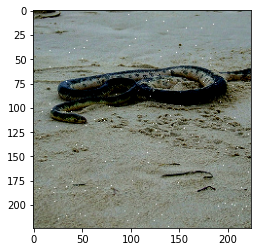

In [72]:
plt.imshow(saved_noisy_imgs_cell_test[0])
print("correct label:", y_val[0])
print("after:", np.argmax(model.predict(np.expand_dims(saved_noisy_imgs_cell_test[0],0)), axis=1)[0])
print("initially:", np.argmax(model.predict(np.expand_dims(x_val[0],0)), axis=1)[0])

<h3>Evolutionary attack</h3>

In [78]:
x_val[0].min()

-217.619

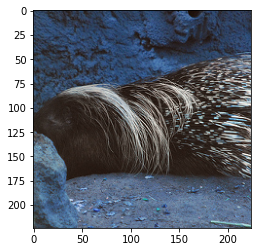

In [166]:
index = 6
plt.imshow((x_val[index]-x_val[index].min()).astype(int))

In [36]:
from tqdm import tqdm

In [37]:
importlib.reload(EvoStrategy)
perturbed_images = 0
adv_evo_strategy = {}
for index in tqdm(range(0,50)):
#     print()
#     print(index)
    img = x_val_raw_sample[index]
#     print(img)
    label = np.argmax(y_val_one_hot_sample[index])
    adv_evo_strategy[index] = EvoStrategy.AdversarialPerturbationEvoStraegy(
        model=model,
        img=img,
        label=label,
        generation_size=15, 
        one_step_perturbation_pixel_count=1,
        verbose=False,
        zero_one_scale=False,
        range_scale_int=True,
#         max_rand=int(x_val.max()),
#         min_rand=int(x_val.min())
        preprocess = preprocess_input
    )
    no_steps = adv_evo_strategy[index].run_adversarial_attack(steps=1000)
    if adv_evo_strategy[index].stop_criterion() and no_steps > 0:
        perturbed_images += 1

100%|██████████| 50/50 [2:06:41<00:00, 152.02s/it]  



50

___________________
Correct label: 841
Initial class: 841
Initial probability to be classified correctly: 0.42421436


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 841 ; Prediction: 735
Fitness: 0.74398


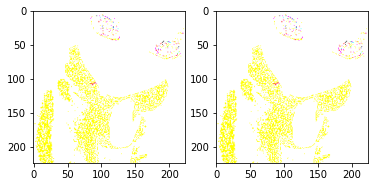


Final probability to be classified correctly: 0.25602004
Final probability to be classified as: 735  is  0.28842896
Queries:  61
_________________________


51

___________________
Correct label: 149
Initial class: 149
Initial probability to be classified correctly: 0.9998357


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 68 generations
Label: 149 ; Prediction: 3
Fitness: 0.5920221


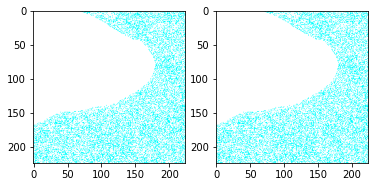


Final probability to be classified correctly: 0.40797812
Final probability to be classified as: 3  is  0.43225834
Queries:  1361
_________________________


52

___________________
Correct label: 21
Initial class: 21
Initial probability to be classified correctly: 0.9640021


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 17 generations
Label: 21 ; Prediction: 99
Fitness: 0.6475204


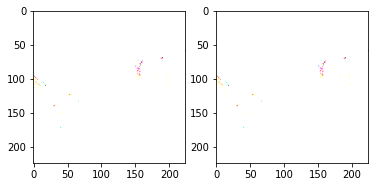


Final probability to be classified correctly: 0.35248002
Final probability to be classified as: 99  is  0.39373854
Queries:  341
_________________________


53

___________________
Correct label: 476
Initial class: 476
Initial probability to be classified correctly: 0.99849534


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 67 generations
Label: 476 ; Prediction: 865
Fitness: 0.719779


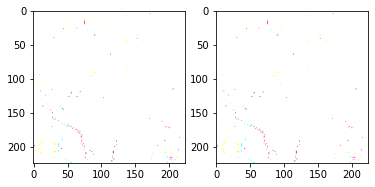


Final probability to be classified correctly: 0.28022128
Final probability to be classified as: 865  is  0.3322225
Queries:  1341
_________________________


54

___________________
Correct label: 80
Initial class: 80
Initial probability to be classified correctly: 0.995108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 121 generations
Label: 80 ; Prediction: 23
Fitness: 0.55687225


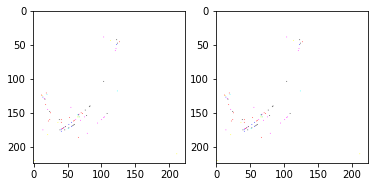


Final probability to be classified correctly: 0.44312742
Final probability to be classified as: 23  is  0.44733354
Queries:  2421
_________________________


55

___________________
Correct label: 424
Initial class: 424
Initial probability to be classified correctly: 0.57254416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 424 ; Prediction: 415
Fitness: 0.52060145


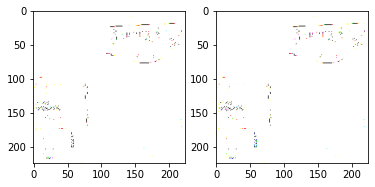


Final probability to be classified correctly: 0.479398
Final probability to be classified as: 415  is  0.4853405
Queries:  101
_________________________


56

___________________
Correct label: 159
Initial class: 159
Initial probability to be classified correctly: 0.9809498


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 81 generations
Label: 159 ; Prediction: 168
Fitness: 0.5139724


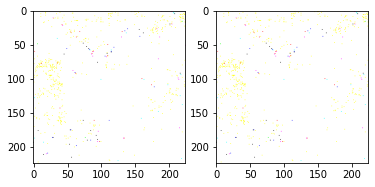


Final probability to be classified correctly: 0.48602805
Final probability to be classified as: 168  is  0.50606346
Queries:  1621
_________________________


57

___________________
Correct label: 275
Initial class: 275
Initial probability to be classified correctly: 0.9991358


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 154 generations
Label: 275 ; Prediction: 276
Fitness: 0.52279246


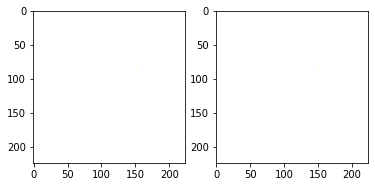


Final probability to be classified correctly: 0.47720668
Final probability to be classified as: 276  is  0.48893672
Queries:  3081
_________________________


58

___________________
Correct label: 175
Initial class: 175
Initial probability to be classified correctly: 0.9926616


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 88 generations
Label: 175 ; Prediction: 170
Fitness: 0.5225662


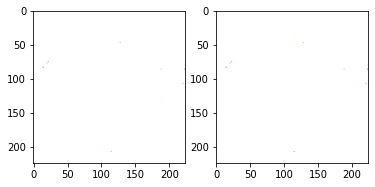


Final probability to be classified correctly: 0.47743362
Final probability to be classified as: 170  is  0.48049998
Queries:  1761
_________________________


59

___________________
Correct label: 461
Initial class: 461
Initial probability to be classified correctly: 0.9670118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 88 generations
Label: 461 ; Prediction: 524
Fitness: 0.50427246


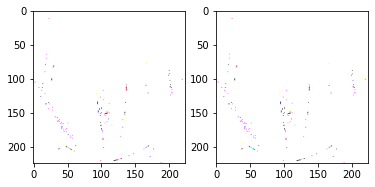


Final probability to be classified correctly: 0.49572608
Final probability to be classified as: 524  is  0.5042092
Queries:  1761
_________________________


60

___________________
Correct label: 970
Initial class: 970
Initial probability to be classified correctly: 0.99096525


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 115 generations
Label: 970 ; Prediction: 671
Fitness: 0.5084864


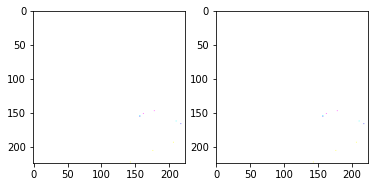


Final probability to be classified correctly: 0.49151456
Final probability to be classified as: 671  is  0.49267653
Queries:  2301
_________________________


61

___________________
Correct label: 160
Initial class: 160
Initial probability to be classified correctly: 0.9999871


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 145 generations
Label: 160 ; Prediction: 224
Fitness: 0.5563625


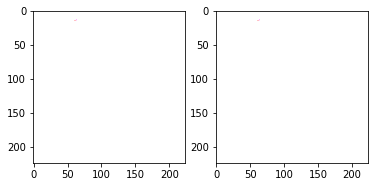


Final probability to be classified correctly: 0.443638
Final probability to be classified as: 224  is  0.45383427
Queries:  2901
_________________________


62

___________________
Correct label: 788
Initial class: 788
Initial probability to be classified correctly: 0.99247605


In [ ]:
# importlib.reload(EvoStrategy)
# # perturbed_images = 0
# # adv_evo_strategy = {}
# for index in range(50,100):
#     print()
#     print(index)
#     img = x_val_raw_sample[index]
# #     print(img)
#     label = np.argmax(y_val_one_hot_sample[index])
#     adv_evo_strategy[index] = EvoStrategy.AdversarialPerturbationEvoStraegy(
#         model=model,
#         img=img,
#         label=label,
#         generation_size=20, 
#         one_step_perturbation_pixel_count=1,
#         verbose=True,
#         zero_one_scale=False,
#         range_scale_int=True,
# #         max_rand=int(x_val.max()),
# #         min_rand=int(x_val.min())
#         preprocess = preprocess_input
#     )
#     no_steps = adv_evo_strategy[index].run_adversarial_attack(steps=1000)
#     if adv_evo_strategy[index].stop_criterion() and no_steps > 0:
#         perturbed_images += 1

In [47]:
for index in range(50):
    if not adv_evo_strategy[index].stop_criterion():
        print(index)

In [ ]:
count_q = 0
sum_q = 0
query_list = []
fair_indices = []
for index in range(50):
    if(adv_evo_strategy[index].queries > 1):
        count_q +=1
        sum_q += adv_evo_strategy[index].queries
        query_list.append(adv_evo_strategy[index].queries)
        fair_indices.append(index)
        
print("Average queries for EVO algo:", sum_q/count_q)
print("Total count of perturbed images (classified correctly initially):", perturbed_images)

In [304]:
np.median(query_list)

728.5

In [302]:
np.mean(query_list)

1242.3636363636363

(array([17., 10.,  3.,  3., 12.,  3.,  0.,  1.,  0.,  1.]),
 array([  31. ,  509.5,  988. , 1466.5, 1945. , 2423.5, 2902. , 3380.5,
        3859. , 4337.5, 4816. ]),
 <a list of 10 Patch objects>)

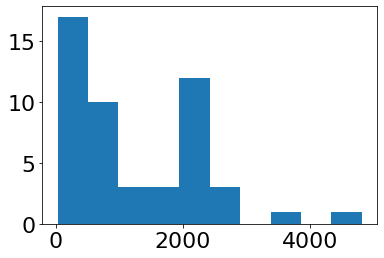

In [305]:
plt.hist(query_list)

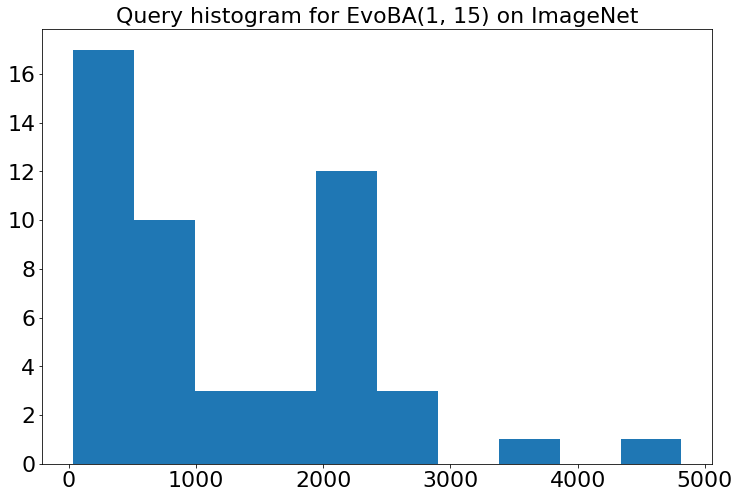

In [306]:
plt.rcParams.update({'font.size': 22})
plt.figure(figsize=(12,8))
plt.title("Query histogram for EvoBA(1, 15) on ImageNet", fontdict={"size":22})
plt.hist(query_list)
plt.show()

In [268]:
import math
from tqdm import tqdm
l0_dists = []
for index_diff in tqdm(fair_indices):
    diff = np.abs(adv_evo_strategy[index_diff].get_best_candidate() - x_val_raw_sample[index_diff])
#     diff = np.reshape(diff, (32, 32, 3))
    diff = (diff!=0)
    l0_dist = np.sum(diff)
    l0_dists.append(l0_dist)
#     print("L2 distance:", math.sqrt(np.sum(np.reshape(diff, (-1))**2)))
#     plt.imshow(np.reshape(adv_evo_strategy[index_diff].get_best_candidate(), (28, 28)))
#     plt.show()
#     print("Prediction:", model.predict(np.array([adv_evo_strategy[index_diff].get_best_candidate()])))

100%|██████████| 33/33 [00:00<00:00, 1719.83it/s]


In [269]:
np.median(l0_dists)

126.0

In [252]:
plt.hist(queries)

NameError: name 'queries' is not defined

In [208]:
np.median(l2_dists)/255

5.692686040527523

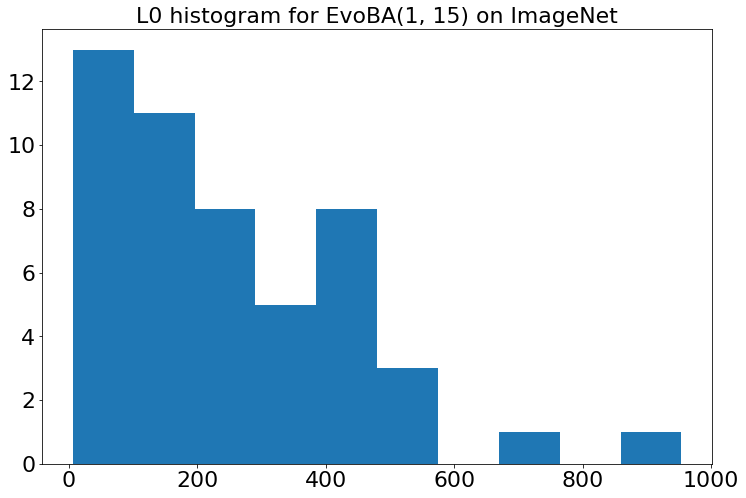

In [265]:
plt.rcParams.update({'font.size': 22})
plt.figure(figsize=(12,8))
plt.title("L0 histogram for EvoBA(1, 15) on ImageNet", fontdict={"size":22})
plt.hist(l0_dists)
plt.show()

In [54]:
import math
l2_dists = []
for index_diff in tqdm(fair_indices):
    diff = np.abs(adv_evo_strategy[index_diff].get_best_candidate() - x_val_raw_sample[index_diff])
#     diff = np.reshape(diff, (32, 32, 3))
    l2_dist = math.sqrt(np.sum(np.reshape(diff, (-1))**2))
    l2_dists.append(l2_dist)
#     print("L2 distance:", math.sqrt(np.sum(np.reshape(diff, (-1))**2)))
#     plt.imshow(np.reshape(adv_evo_strategy[index_diff].get_best_candidate(), (28, 28)))
#     plt.show()
#     print("Prediction:", model.predict(np.array([adv_evo_strategy[index_diff].get_best_candidate()])))

100%|██████████| 33/33 [00:00<00:00, 3215.07it/s]


In [55]:
np.shape(x_val_sample[0])

(224, 224, 3)

In [56]:
np.mean(l2_dists)/255

6.090783686156781

In [57]:
np.mean(l2_dists)/(255 * 224 * 224 * 3)

4.046279553409852e-05

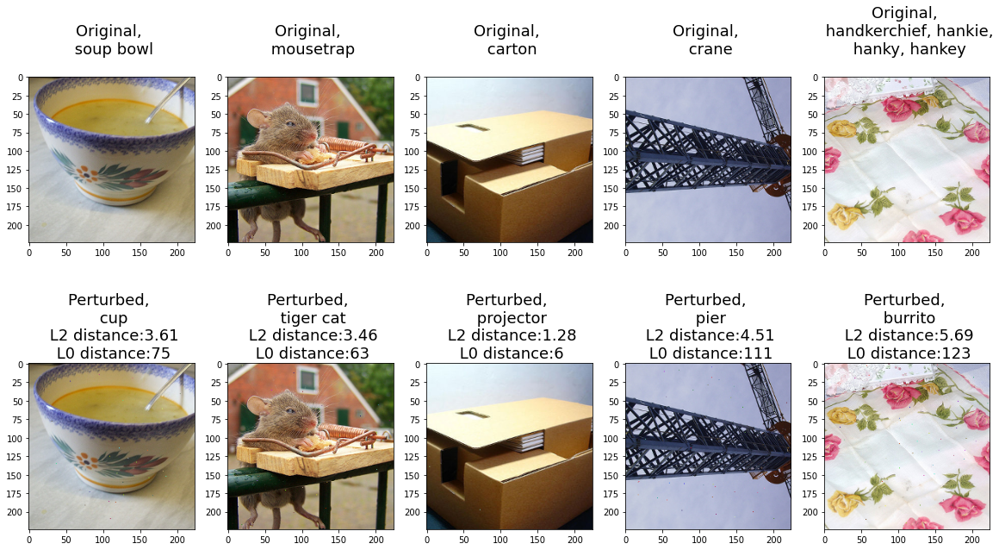

In [196]:
w=10
h=10
fig=plt.figure(figsize=(20, 9))
fig.tight_layout()
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=0.1, wspace=0.2)

columns = 5
rows = 2
img_curr = 0
for i in range(1, columns + 1):
    img_indx = fair_indices[imgss[img_curr]]
    initial = (keras_idx_to_name[adv_evo_strategy[img_indx].label])
    if len(initial) > 30:
        initial = initial[:21] + "\n" + initial[21:]
    fig.add_subplot(rows, columns, i)
    plt.title(f"Original, \n {initial}", fontdict={"size":18})
    img_start = adv_evo_strategy[img_indx].img.astype(int)
    plt.imshow(img_start)
    
    fig.add_subplot(rows, columns, i + 5)
    
    img_final = adv_evo_strategy[img_indx].get_best_candidate().astype(int)
    predss = model.predict(np.expand_dims(img_final, axis=0))[0]
    predicted = np.argmax(predss)
    diff = math.sqrt(np.sum((img_final - img_start) **2))
    l2_distance = int((diff/(255)) * 100)/100
    l0_distance = (img_start != img_final).sum()
    final = (keras_idx_to_name[predicted])
    plt.title(f"Perturbed, \n {final} L2 distance:{l2_distance}\n L0 distance:{l0_distance}", fontdict={"size":18})
    plt.imshow(img_final)
    img_curr += 1
plt.show()

  0%|          | 0/5 [00:00<?, ?it/s]

3


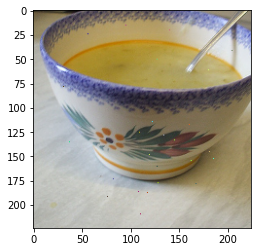

 20%|██        | 1/5 [00:00<00:01,  2.98it/s]

8


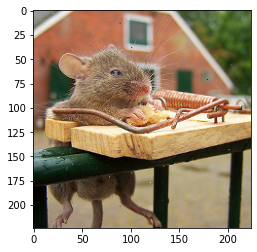

 40%|████      | 2/5 [00:00<00:00,  3.05it/s]

16


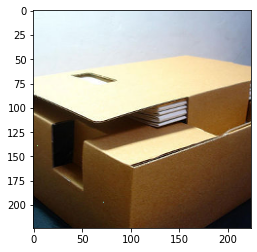

 60%|██████    | 3/5 [00:00<00:00,  2.98it/s]

17


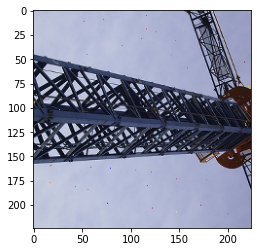

 80%|████████  | 4/5 [00:01<00:00,  2.97it/s]

43


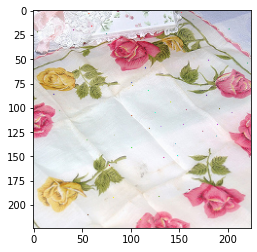

100%|██████████| 5/5 [00:01<00:00,  3.09it/s]


In [146]:
for index_diff in tqdm(np.array(fair_indices)[imgss]):
    print(index_diff)
    initial = (keras_idx_to_name[adv_evo_strategy[index_diff].label])
    img = adv_evo_strategy[index_diff].get_best_candidate().astype(int)
    plt.imshow(img.astype(int))
    predicted = (np.argmax(model.predict(np.expand_dims(img, axis=0))[0]))
    final = (keras_idx_to_name[predicted])
    plt.show()

  0%|          | 0/708 [00:00<?, ?it/s]


___________________
Correct label: 65
Initial class: 65
Initial probability to be classified correctly: 0.81139535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 21 generations
Label: 65 ; Prediction: 62
Fitness: 0.6877985


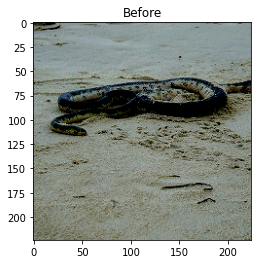

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


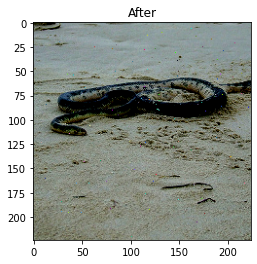


Final probability to be classified correctly: 0.3122015
Final probability to be classified as: 62  is  0.31611788
Queries 421
_________________________



  0%|          | 2/708 [00:30<3:49:46, 19.53s/it]

  0%|          | 3/708 [01:09<4:58:45, 25.43s/it]

  1%|          | 6/708 [06:28<16:09:13, 82.84s/it]

  1%|          | 7/708 [06:58<13:04:20, 67.13s/it]

  1%|          | 8/708 [07:28<10:51:46, 55.87s/it]

  1%|▏         | 10/708 [10:20<14:01:34, 72.34s/it]



___________________
Correct label: 478
Initial class: 478
Initial probability to be classified correctly: 0.95922863


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 478 ; Prediction: 553
Fitness: 0.6102359


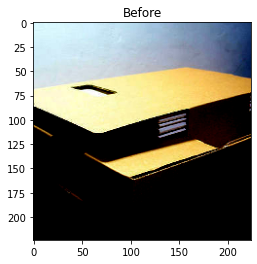

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


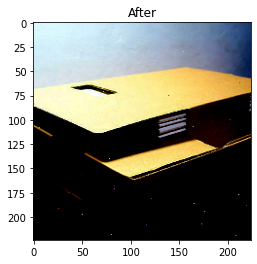


Final probability to be classified correctly: 0.38976407


  2%|▏         | 11/708 [10:26<10:10:13, 52.53s/it]

Final probability to be classified as: 553  is  0.45051122
Queries 101
_________________________



  2%|▏         | 12/708 [10:39<7:51:34, 40.65s/it] 

  2%|▏         | 13/708 [11:23<8:01:45, 41.59s/it]

  2%|▏         | 16/708 [16:20<13:43:36, 71.41s/it]

  2%|▏         | 17/708 [16:21<9:40:50, 50.43s/it] 

  3%|▎         | 18/708 [17:48<11:46:14, 61.41s/it]

  3%|▎         | 19/708 [18:25<10:21:00, 54.08s/it]

  3%|▎         | 20/708 [18:36<7:49:40, 40.96s/it] 



___________________
Correct label: 324
Initial class: 324
Initial probability to be classified correctly: 0.97705966


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 27 generations
Label: 324 ; Prediction: 325
Fitness: 0.5091077


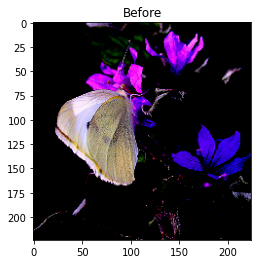

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


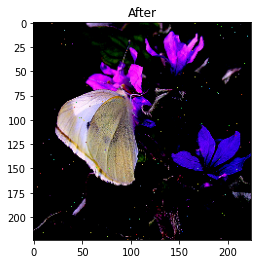


Final probability to be classified correctly: 0.49089232
Final probability to be classified as: 325  is  0.5067474
Queries 541
_________________________



  3%|▎         | 22/708 [19:11<5:19:57, 27.98s/it]

  3%|▎         | 23/708 [19:16<3:58:59, 20.93s/it]

  3%|▎         | 24/708 [19:50<4:44:37, 24.97s/it]

  4%|▎         | 25/708 [21:24<8:39:32, 45.64s/it]

  4%|▎         | 26/708 [21:31<6:28:29, 34.18s/it]

  4%|▍         | 28/708 [22:19<5:38:12, 29.84s/it]

  4%|▍         | 29/708 [22:44<5:18:27, 28.14s/it]

  4%|▍         | 30/708 [23:11<5:16:00, 27.97s/it]



___________________
Correct label: 725
Initial class: 725
Initial probability to be classified correctly: 0.5410388


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 9 generations
Label: 725 ; Prediction: 606
Fitness: 0.78314567


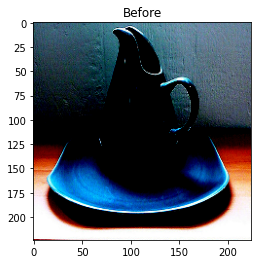

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


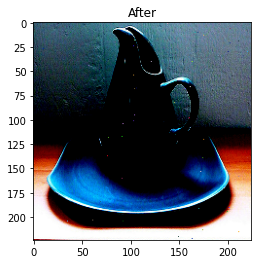


Final probability to be classified correctly: 0.21685436


  4%|▍         | 31/708 [23:21<4:15:45, 22.67s/it]

Final probability to be classified as: 606  is  0.24951719
Queries 181
_________________________



  5%|▍         | 32/708 [23:30<3:27:42, 18.44s/it]

  5%|▍         | 33/708 [23:46<3:20:41, 17.84s/it]

  5%|▍         | 34/708 [23:56<2:52:36, 15.37s/it]

  5%|▌         | 36/708 [27:07<10:00:46, 53.64s/it]

  5%|▌         | 37/708 [27:42<8:57:42, 48.08s/it] 

  6%|▌         | 39/708 [28:59<8:32:53, 46.00s/it]

  6%|▌         | 40/708 [29:20<7:09:16, 38.56s/it]



___________________
Correct label: 474
Initial class: 474
Initial probability to be classified correctly: 0.8436785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 10 generations
Label: 474 ; Prediction: 735
Fitness: 0.54747045


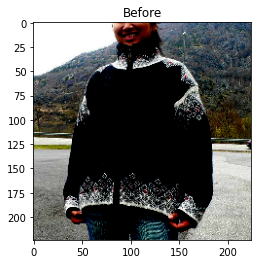

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


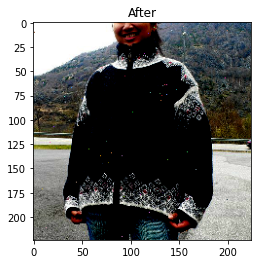


Final probability to be classified correctly: 0.45252958


  6%|▌         | 41/708 [29:32<5:38:27, 30.45s/it]

Final probability to be classified as: 735  is  0.52472234
Queries 201
_________________________



  6%|▌         | 42/708 [29:34<4:04:43, 22.05s/it]

  6%|▌         | 43/708 [29:41<3:12:52, 17.40s/it]

  6%|▌         | 44/708 [30:07<3:41:10, 19.98s/it]

  6%|▋         | 45/708 [30:49<4:55:29, 26.74s/it]

  6%|▋         | 46/708 [31:07<4:26:41, 24.17s/it]

  7%|▋         | 47/708 [31:23<3:58:00, 21.60s/it]

  7%|▋         | 48/708 [31:48<4:07:26, 22.49s/it]

  7%|▋         | 49/708 [31:52<3:07:11, 17.04s/it]

  7%|▋         | 50/708 [32:09<3:05:52, 16.95s/it]



___________________
Correct label: 80
Initial class: 80
Initial probability to be classified correctly: 0.99979454
Final probability to be classified correctly: 0.53358006
Final probability to be classified as: 80  is  0.53358006
Queries 2001
_________________________



  7%|▋         | 52/708 [34:18<6:35:05, 36.14s/it]

  7%|▋         | 53/708 [34:27<5:06:37, 28.09s/it]

  8%|▊         | 54/708 [35:01<5:22:33, 29.59s/it]

  8%|▊         | 55/708 [35:05<3:59:47, 22.03s/it]

  8%|▊         | 56/708 [35:51<5:18:34, 29.32s/it]

  8%|▊         | 57/708 [36:22<5:23:51, 29.85s/it]

  8%|▊         | 58/708 [37:15<6:37:54, 36.73s/it]

  8%|▊         | 59/708 [37:22<5:01:40, 27.89s/it]

  8%|▊         | 60/708 [38:00<5:31:41, 30.71s/it]



___________________
Correct label: 369
Initial class: 369
Initial probability to be classified correctly: 0.33897948


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 1 generations
Label: 369 ; Prediction: 364
Fitness: 0.8352927


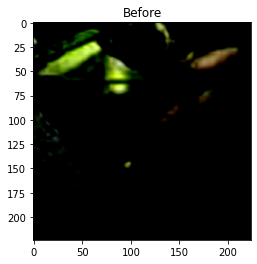

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


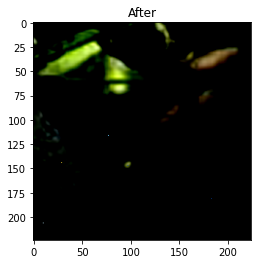


Final probability to be classified correctly: 0.16470733


  9%|▊         | 61/708 [38:02<3:59:01, 22.17s/it]

Final probability to be classified as: 364  is  0.28504676
Queries 21
_________________________



  9%|▉         | 62/708 [38:08<3:07:55, 17.45s/it]

  9%|▉         | 63/708 [38:56<4:44:53, 26.50s/it]

  9%|▉         | 64/708 [39:25<4:51:09, 27.13s/it]

  9%|▉         | 65/708 [40:43<7:37:00, 42.64s/it]

  9%|▉         | 66/708 [41:00<6:14:07, 34.96s/it]

  9%|▉         | 67/708 [41:40<6:27:15, 36.25s/it]

 10%|▉         | 68/708 [42:03<5:46:10, 32.45s/it]

 10%|▉         | 69/708 [42:11<4:25:27, 24.93s/it]

 10%|▉         | 70/708 [42:33<4:16:54, 24.16s/it]



___________________
Correct label: 949
Initial class: 949
Initial probability to be classified correctly: 0.9994604


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 58 generations
Label: 949 ; Prediction: 956
Fitness: 0.5202443


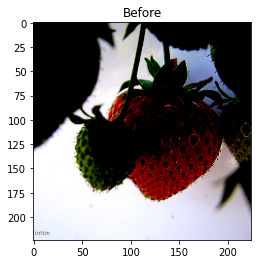

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


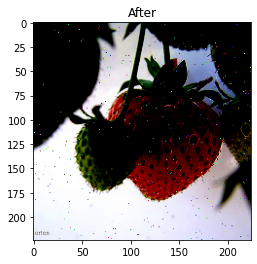


Final probability to be classified correctly: 0.4797557
Final probability to be classified as: 956  is  0.51918805
Queries 1161
_________________________



 10%|█         | 72/708 [43:58<5:32:34, 31.38s/it]

 10%|█         | 73/708 [44:03<4:09:22, 23.56s/it]

 10%|█         | 74/708 [44:10<3:17:33, 18.70s/it]

 11%|█         | 75/708 [44:20<2:47:48, 15.91s/it]

 11%|█         | 76/708 [44:38<2:54:54, 16.61s/it]

 11%|█         | 77/708 [44:44<2:22:22, 13.54s/it]

 11%|█         | 78/708 [45:25<3:47:30, 21.67s/it]

 11%|█         | 79/708 [45:26<2:43:41, 15.61s/it]

 11%|█▏        | 80/708 [45:34<2:17:17, 13.12s/it]



___________________
Correct label: 122
Initial class: 122
Initial probability to be classified correctly: 0.9475455


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 30 generations
Label: 122 ; Prediction: 934
Fitness: 0.6656455


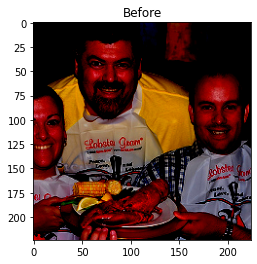

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


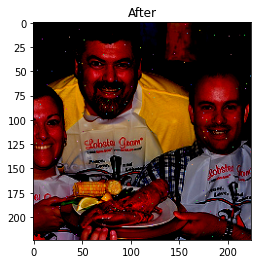


Final probability to be classified correctly: 0.3343545
Final probability to be classified as: 934  is  0.36934075
Queries 601
_________________________



 12%|█▏        | 82/708 [46:24<3:14:18, 18.62s/it]

 12%|█▏        | 83/708 [46:35<2:49:10, 16.24s/it]

 12%|█▏        | 84/708 [47:31<4:54:31, 28.32s/it]

 12%|█▏        | 85/708 [47:38<3:48:50, 22.04s/it]

 12%|█▏        | 86/708 [48:55<6:37:34, 38.35s/it]

 12%|█▏        | 87/708 [49:03<5:04:32, 29.42s/it]

 12%|█▏        | 88/708 [49:24<4:35:16, 26.64s/it]

 13%|█▎        | 89/708 [49:40<4:02:57, 23.55s/it]

 13%|█▎        | 90/708 [50:25<5:10:04, 30.10s/it]



___________________
Correct label: 934
Initial class: 934
Initial probability to be classified correctly: 0.64082783


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 934 ; Prediction: 924
Fitness: 0.6731782


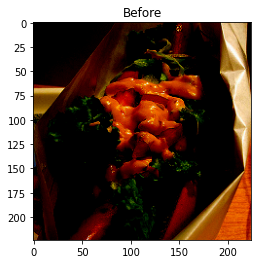

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


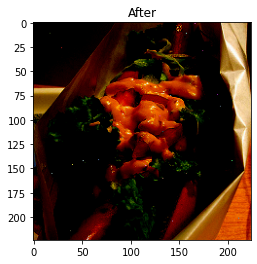


Final probability to be classified correctly: 0.32682183


 13%|█▎        | 91/708 [50:32<3:56:11, 22.97s/it]

Final probability to be classified as: 924  is  0.3830757
Queries 101
_________________________



 13%|█▎        | 92/708 [51:10<4:44:07, 27.67s/it]

 13%|█▎        | 93/708 [52:23<7:01:14, 41.10s/it]

 13%|█▎        | 94/708 [52:35<5:33:17, 32.57s/it]

 13%|█▎        | 95/708 [54:27<9:36:05, 56.39s/it]

 14%|█▎        | 96/708 [54:41<7:24:25, 43.57s/it]

 14%|█▎        | 97/708 [55:54<8:54:39, 52.50s/it]

 14%|█▍        | 98/708 [55:57<6:21:01, 37.48s/it]

 14%|█▍        | 99/708 [56:11<5:08:09, 30.36s/it]

 14%|█▍        | 100/708 [56:54<5:46:07, 34.16s/it]



___________________
Correct label: 771
Initial class: 771
Initial probability to be classified correctly: 0.99845517


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 27 generations
Label: 771 ; Prediction: 745
Fitness: 0.7123689


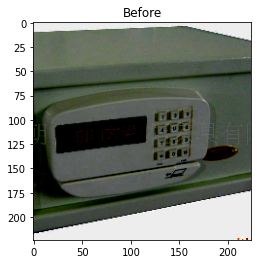

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


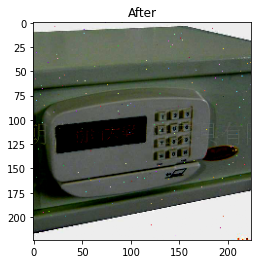


Final probability to be classified correctly: 0.2876311
Final probability to be classified as: 745  is  0.3085893
Queries 541
_________________________



 14%|█▍        | 102/708 [57:55<5:30:06, 32.68s/it]

 15%|█▍        | 104/708 [1:00:02<7:15:32, 43.27s/it]

 15%|█▍        | 105/708 [1:00:50<7:27:41, 44.55s/it]

 15%|█▍        | 106/708 [1:00:52<5:20:08, 31.91s/it]

 15%|█▌        | 107/708 [1:01:07<4:26:42, 26.63s/it]

 15%|█▌        | 109/708 [1:03:30<7:30:20, 45.11s/it]

 16%|█▌        | 110/708 [1:03:39<5:41:07, 34.23s/it]



___________________
Correct label: 277
Initial class: 277
Initial probability to be classified correctly: 0.67696464


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 11 generations
Label: 277 ; Prediction: 278
Fitness: 0.5106666


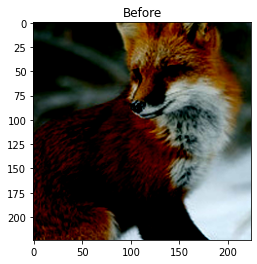

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


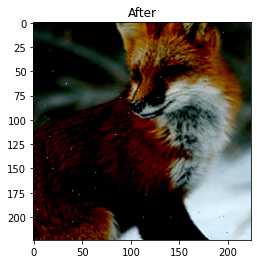


Final probability to be classified correctly: 0.48933342
Final probability to be classified as: 278  is  0.50105804
Queries 221
_________________________



 16%|█▌        | 112/708 [1:04:45<5:54:21, 35.67s/it]

 16%|█▌        | 114/708 [1:07:04<7:56:45, 48.16s/it] 

 16%|█▌        | 115/708 [1:07:25<6:35:19, 40.00s/it]

 16%|█▋        | 116/708 [1:08:52<8:52:37, 53.98s/it]

 17%|█▋        | 118/708 [1:11:19<9:46:26, 59.64s/it] 

 17%|█▋        | 119/708 [1:11:20<6:53:56, 42.17s/it]

 17%|█▋        | 120/708 [1:13:23<10:48:58, 66.22s/it]


___________________
Correct label: 158
Initial class: 158
Initial probability to be classified correctly: 0.6525823


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 158 ; Prediction: 151
Fitness: 0.53147936


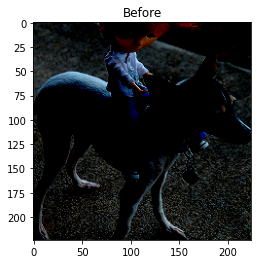

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


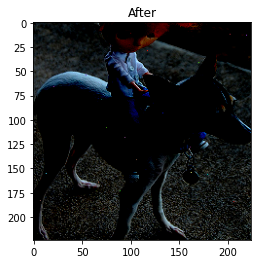


Final probability to be classified correctly: 0.46852064


 17%|█▋        | 121/708 [1:13:28<7:48:08, 47.85s/it] 

Final probability to be classified as: 151  is  0.49550152
Queries 81
_________________________



 17%|█▋        | 122/708 [1:14:36<8:46:04, 53.86s/it]

 17%|█▋        | 123/708 [1:15:09<7:46:43, 47.87s/it]

 18%|█▊        | 124/708 [1:15:54<7:36:11, 46.87s/it]

 18%|█▊        | 125/708 [1:16:07<5:55:34, 36.59s/it]

 18%|█▊        | 126/708 [1:16:31<5:20:43, 33.07s/it]

 18%|█▊        | 127/708 [1:17:22<6:10:29, 38.26s/it]

 18%|█▊        | 128/708 [1:17:45<5:24:54, 33.61s/it]

 18%|█▊        | 129/708 [1:18:52<7:03:22, 43.87s/it]

 18%|█▊        | 130/708 [1:20:01<8:14:38, 51.35s/it]



___________________
Correct label: 627
Initial class: 627
Initial probability to be classified correctly: 0.4787691


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 627 ; Prediction: 654
Fitness: 0.71917164


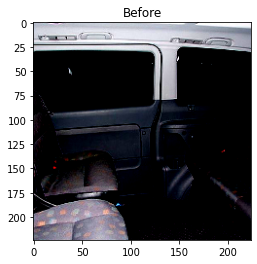

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


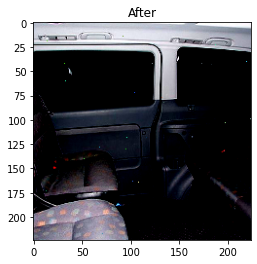


Final probability to be classified correctly: 0.28082836
Final probability to be classified as: 654  is  0.3372053
Queries 81
_________________________



 19%|█▊        | 132/708 [1:20:17<4:42:55, 29.47s/it]

 19%|█▉        | 133/708 [1:20:43<4:30:59, 28.28s/it]

 19%|█▉        | 134/708 [1:20:59<3:55:41, 24.64s/it]

 19%|█▉        | 135/708 [1:21:30<4:13:34, 26.55s/it]

 19%|█▉        | 136/708 [1:21:41<3:28:44, 21.90s/it]

 19%|█▉        | 137/708 [1:21:57<3:13:23, 20.32s/it]

 19%|█▉        | 138/708 [1:22:08<2:45:37, 17.43s/it]

 20%|█▉        | 139/708 [1:23:32<5:53:47, 37.31s/it]

 20%|█▉        | 140/708 [1:23:45<4:46:17, 30.24s/it]



___________________
Correct label: 396
Initial class: 396
Initial probability to be classified correctly: 0.99999475
Final probability to be classified correctly: 0.86010647
Final probability to be classified as: 396  is  0.86010647
Queries 2001
_________________________



 20%|██        | 142/708 [1:26:05<7:12:39, 45.87s/it]

 20%|██        | 143/708 [1:26:15<5:30:25, 35.09s/it]

 20%|██        | 144/708 [1:26:54<5:40:48, 36.26s/it]

 20%|██        | 145/708 [1:28:25<8:12:55, 52.53s/it]

 21%|██        | 146/708 [1:29:09<7:47:50, 49.95s/it]

 21%|██        | 147/708 [1:29:22<6:03:20, 38.86s/it]

 21%|██        | 148/708 [1:29:39<5:01:06, 32.26s/it]

 21%|██        | 149/708 [1:29:51<4:03:51, 26.17s/it]

 21%|██        | 150/708 [1:31:52<8:30:14, 54.86s/it]


___________________
Correct label: 922
Initial class: 922
Initial probability to be classified correctly: 0.9272757


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 20 generations
Label: 922 ; Prediction: 921
Fitness: 0.57425785


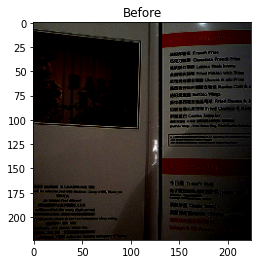

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


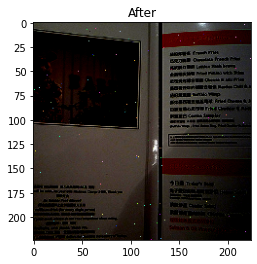


Final probability to be classified correctly: 0.42574218
Final probability to be classified as: 921  is  0.44776225
Queries 401
_________________________



 21%|██▏       | 152/708 [1:33:18<7:49:21, 50.65s/it]

 22%|██▏       | 153/708 [1:33:21<5:37:08, 36.45s/it]

 22%|██▏       | 154/708 [1:35:18<9:19:03, 60.55s/it]

 22%|██▏       | 155/708 [1:35:34<7:15:47, 47.28s/it]

 22%|██▏       | 156/708 [1:37:35<10:37:48, 69.33s/it]

 22%|██▏       | 157/708 [1:38:36<10:13:39, 66.82s/it]

 22%|██▏       | 158/708 [1:39:09<8:40:19, 56.76s/it] 

 22%|██▏       | 159/708 [1:39:20<6:33:16, 42.98s/it]

 23%|██▎       | 160/708 [1:39:48<5:51:46, 38.52s/it]



___________________
Correct label: 636
Initial class: 636
Initial probability to be classified correctly: 0.64494234


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 2 generations
Label: 636 ; Prediction: 748
Fitness: 0.5493145


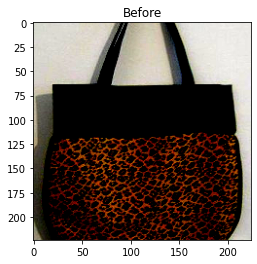

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


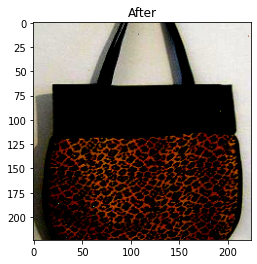


Final probability to be classified correctly: 0.45068547
Final probability to be classified as: 748  is  0.54883033
Queries 41
_________________________



 23%|██▎       | 162/708 [1:39:57<3:14:30, 21.37s/it]

 23%|██▎       | 163/708 [1:40:32<3:50:24, 25.37s/it]

 23%|██▎       | 164/708 [1:41:39<5:42:54, 37.82s/it]

 23%|██▎       | 165/708 [1:41:49<4:27:31, 29.56s/it]

 23%|██▎       | 166/708 [1:42:17<4:21:56, 29.00s/it]

 24%|██▎       | 167/708 [1:42:18<3:06:41, 20.70s/it]

 24%|██▍       | 170/708 [1:46:45<8:33:40, 57.29s/it] 



___________________
Correct label: 167
Initial class: 167
Initial probability to be classified correctly: 0.79133546


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 167 ; Prediction: 210
Fitness: 0.56450534


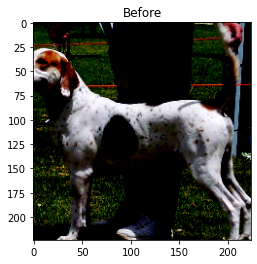

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


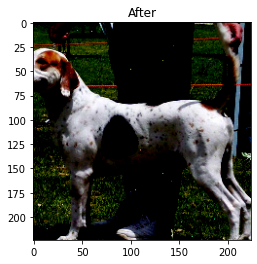


Final probability to be classified correctly: 0.4354947


 24%|██▍       | 171/708 [1:46:50<6:14:30, 41.85s/it]

Final probability to be classified as: 210  is  0.49924672
Queries 101
_________________________



 24%|██▍       | 172/708 [1:47:01<4:51:07, 32.59s/it]

 24%|██▍       | 173/708 [1:47:03<3:27:13, 23.24s/it]

 25%|██▍       | 174/708 [1:47:40<4:04:40, 27.49s/it]

 25%|██▍       | 175/708 [1:48:12<4:15:40, 28.78s/it]

 25%|██▍       | 176/708 [1:48:38<4:06:35, 27.81s/it]

 25%|██▌       | 177/708 [1:49:27<5:02:40, 34.20s/it]

 25%|██▌       | 178/708 [1:49:47<4:24:06, 29.90s/it]

 25%|██▌       | 179/708 [1:50:58<6:14:41, 42.50s/it]

 25%|██▌       | 180/708 [1:51:20<5:18:04, 36.14s/it]



___________________
Correct label: 983
Initial class: 983
Initial probability to be classified correctly: 0.33232185


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 983 ; Prediction: 973
Fitness: 0.77383673


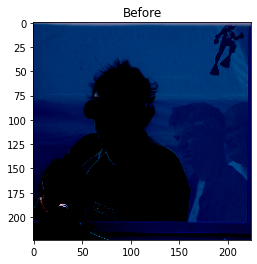

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


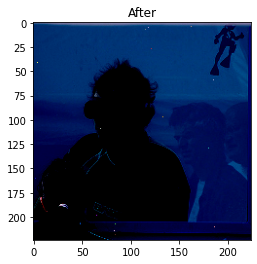


Final probability to be classified correctly: 0.22616327


 26%|██▌       | 181/708 [1:51:24<3:53:52, 26.63s/it]

Final probability to be classified as: 973  is  0.23328216
Queries 61
_________________________



 26%|██▌       | 182/708 [1:52:18<5:04:48, 34.77s/it]

 26%|██▌       | 183/708 [1:52:21<3:41:45, 25.34s/it]

 26%|██▌       | 185/708 [1:54:35<6:02:10, 41.55s/it]

 26%|██▋       | 186/708 [1:54:55<5:04:27, 34.99s/it]

 26%|██▋       | 187/708 [1:54:59<3:43:38, 25.76s/it]

 27%|██▋       | 188/708 [1:55:52<4:54:17, 33.96s/it]

 27%|██▋       | 189/708 [1:55:54<3:31:46, 24.48s/it]

 27%|██▋       | 190/708 [1:56:08<3:03:26, 21.25s/it]



___________________
Correct label: 925
Initial class: 925
Initial probability to be classified correctly: 0.5611646


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 1 generations
Label: 925 ; Prediction: 809
Fitness: 0.5778285


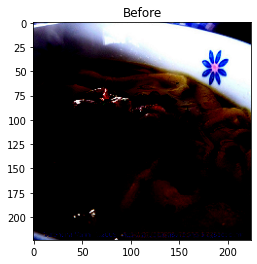

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


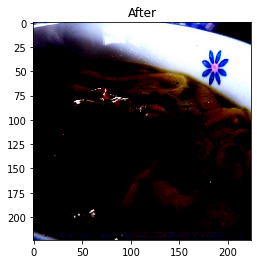


Final probability to be classified correctly: 0.42217144
Final probability to be classified as: 809  is  0.55501646
Queries 21
_________________________



 27%|██▋       | 192/708 [1:56:55<3:30:19, 24.46s/it]

 27%|██▋       | 193/708 [1:57:44<4:31:02, 31.58s/it]

 27%|██▋       | 194/708 [1:58:46<5:49:44, 40.83s/it]

 28%|██▊       | 195/708 [1:58:52<4:19:56, 30.40s/it]

 28%|██▊       | 196/708 [1:59:01<3:23:15, 23.82s/it]

 28%|██▊       | 197/708 [2:00:54<7:12:01, 50.73s/it]

 28%|██▊       | 200/708 [2:05:13<9:15:21, 65.59s/it] 



___________________
Correct label: 881
Initial class: 881
Initial probability to be classified correctly: 0.9998659


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 74 generations
Label: 881 ; Prediction: 579
Fitness: 0.50864303


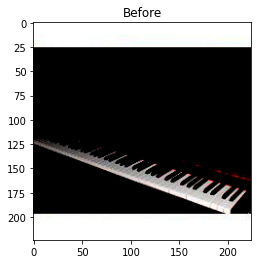

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


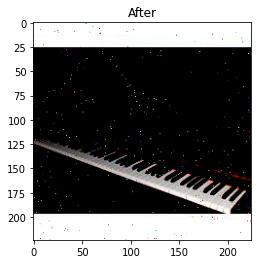


Final probability to be classified correctly: 0.491357
Final probability to be classified as: 579  is  0.50826913
Queries 1481
_________________________



 29%|██▊       | 202/708 [2:06:55<7:46:33, 55.32s/it]

 29%|██▊       | 203/708 [2:07:09<6:01:18, 42.93s/it]

 29%|██▉       | 204/708 [2:07:27<4:56:26, 35.29s/it]

 29%|██▉       | 205/708 [2:07:30<3:35:20, 25.69s/it]

 29%|██▉       | 206/708 [2:07:39<2:52:59, 20.68s/it]

 29%|██▉       | 207/708 [2:08:07<3:09:33, 22.70s/it]

 29%|██▉       | 208/708 [2:08:27<3:03:18, 22.00s/it]

 30%|██▉       | 209/708 [2:09:00<3:29:47, 25.22s/it]

 30%|██▉       | 210/708 [2:09:17<3:10:36, 22.96s/it]



___________________
Correct label: 329
Initial class: 329
Initial probability to be classified correctly: 0.4472549


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 329 ; Prediction: 116
Fitness: 0.6595688


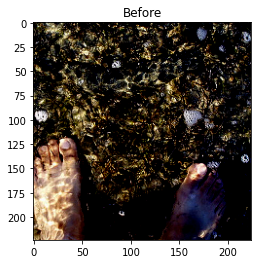

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


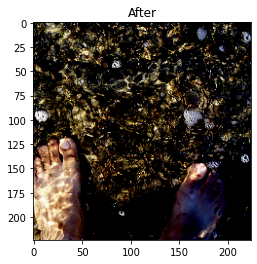


Final probability to be classified correctly: 0.34043118
Final probability to be classified as: 116  is  0.36314374
Queries 81
_________________________



 30%|██▉       | 212/708 [2:10:26<4:20:40, 31.53s/it]

 30%|███       | 213/708 [2:10:32<3:14:56, 23.63s/it]

 30%|███       | 214/708 [2:11:16<4:05:46, 29.85s/it]

 30%|███       | 215/708 [2:12:00<4:40:00, 34.08s/it]

 31%|███       | 216/708 [2:12:09<3:38:08, 26.60s/it]

 31%|███       | 217/708 [2:12:28<3:18:32, 24.26s/it]

 31%|███       | 219/708 [2:14:37<5:24:14, 39.78s/it]

 31%|███       | 220/708 [2:16:08<7:28:37, 55.16s/it]



___________________
Correct label: 102
Initial class: 102
Initial probability to be classified correctly: 0.9998535
Final probability to be classified correctly: 0.9471798
Final probability to be classified as: 102  is  0.9471798
Queries 2001
_________________________



 31%|███▏      | 222/708 [2:18:32<7:59:33, 59.20s/it] 

 31%|███▏      | 223/708 [2:19:13<7:13:16, 53.60s/it]

 32%|███▏      | 224/708 [2:19:38<6:05:16, 45.28s/it]

 32%|███▏      | 225/708 [2:20:22<6:01:22, 44.89s/it]

 32%|███▏      | 226/708 [2:21:03<5:49:47, 43.54s/it]

 32%|███▏      | 227/708 [2:21:39<5:31:45, 41.38s/it]

 32%|███▏      | 228/708 [2:23:24<8:03:09, 60.39s/it]

 32%|███▏      | 229/708 [2:23:25<5:40:52, 42.70s/it]

 32%|███▏      | 230/708 [2:24:03<5:28:20, 41.21s/it]



___________________
Correct label: 938
Initial class: 938
Initial probability to be classified correctly: 0.9995906


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 36 generations
Label: 938 ; Prediction: 936
Fitness: 0.52303696


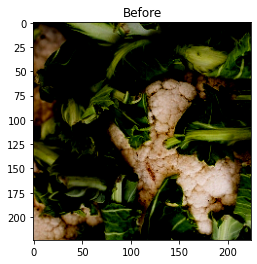

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


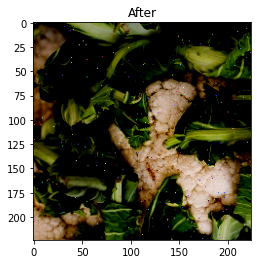


Final probability to be classified correctly: 0.47696304
Final probability to be classified as: 936  is  0.48440298
Queries 721
_________________________



 33%|███▎      | 232/708 [2:24:46<3:57:10, 29.90s/it]

 33%|███▎      | 233/708 [2:25:07<3:36:07, 27.30s/it]

 33%|███▎      | 234/708 [2:25:11<2:38:46, 20.10s/it]

 33%|███▎      | 235/708 [2:26:09<4:08:23, 31.51s/it]

 33%|███▎      | 237/708 [2:28:50<6:54:42, 52.83s/it]

 34%|███▎      | 238/708 [2:29:29<6:22:24, 48.82s/it]

 34%|███▍      | 239/708 [2:29:43<4:59:53, 38.37s/it]

 34%|███▍      | 240/708 [2:30:38<5:37:08, 43.22s/it]



___________________
Correct label: 293
Initial class: 293
Initial probability to be classified correctly: 0.9947602


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 69 generations
Label: 293 ; Prediction: 288
Fitness: 0.5055682


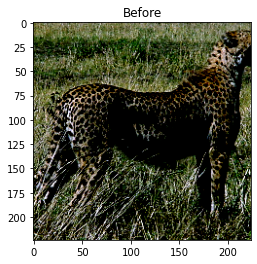

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


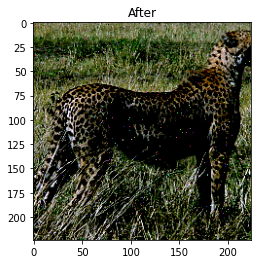


Final probability to be classified correctly: 0.4944318
Final probability to be classified as: 288  is  0.50428456
Queries 1381
_________________________



 34%|███▍      | 242/708 [2:32:19<5:48:35, 44.88s/it]

 34%|███▍      | 243/708 [2:32:30<4:29:04, 34.72s/it]

 34%|███▍      | 244/708 [2:32:38<3:24:29, 26.44s/it]

 35%|███▍      | 245/708 [2:32:44<2:37:15, 20.38s/it]

 35%|███▍      | 246/708 [2:33:20<3:12:50, 25.05s/it]

 35%|███▍      | 247/708 [2:34:21<4:35:48, 35.90s/it]

 35%|███▌      | 248/708 [2:35:02<4:46:23, 37.35s/it]

 35%|███▌      | 249/708 [2:35:11<3:41:03, 28.90s/it]

 35%|███▌      | 250/708 [2:35:26<3:08:15, 24.66s/it]



___________________
Correct label: 300
Initial class: 300
Initial probability to be classified correctly: 0.9999343
Final probability to be classified correctly: 0.9818346
Final probability to be classified as: 300  is  0.9818346
Queries 2001
_________________________



 36%|███▌      | 252/708 [2:39:26<9:17:23, 73.34s/it]

 36%|███▌      | 253/708 [2:41:18<10:44:27, 84.98s/it]

 36%|███▌      | 254/708 [2:41:25<7:43:56, 61.31s/it] 

 36%|███▌      | 255/708 [2:41:35<5:48:24, 46.15s/it]

 36%|███▌      | 256/708 [2:41:51<4:39:03, 37.04s/it]

 36%|███▋      | 257/708 [2:43:36<7:10:38, 57.29s/it]

 36%|███▋      | 258/708 [2:43:51<5:35:48, 44.77s/it]

 37%|███▋      | 259/708 [2:44:11<4:38:24, 37.20s/it]

 37%|███▋      | 260/708 [2:46:12<7:46:13, 62.44s/it]


___________________
Correct label: 694
Initial class: 694
Initial probability to be classified correctly: 0.99985754
Final probability to be classified correctly: 0.76413417
Final probability to be classified as: 694  is  0.76413417
Queries 2001
_________________________



 37%|███▋      | 262/708 [2:48:43<8:02:01, 64.85s/it]

 37%|███▋      | 263/708 [2:49:01<6:17:37, 50.92s/it]

 37%|███▋      | 264/708 [2:49:15<4:54:38, 39.82s/it]

 37%|███▋      | 265/708 [2:49:30<3:58:41, 32.33s/it]

 38%|███▊      | 266/708 [2:49:58<3:49:36, 31.17s/it]

 38%|███▊      | 267/708 [2:50:38<4:08:09, 33.76s/it]

 38%|███▊      | 268/708 [2:51:43<5:16:29, 43.16s/it]

 38%|███▊      | 269/708 [2:52:34<5:32:38, 45.46s/it]

 38%|███▊      | 270/708 [2:53:51<6:41:27, 54.99s/it]



___________________
Correct label: 420
Initial class: 420
Initial probability to be classified correctly: 0.99995637
Final probability to be classified correctly: 0.7174867
Final probability to be classified as: 420  is  0.7174867
Queries 2001
_________________________



 38%|███▊      | 272/708 [2:55:59<6:34:28, 54.29s/it]

 39%|███▊      | 273/708 [2:56:43<6:12:10, 51.33s/it]

 39%|███▊      | 274/708 [2:57:32<6:06:08, 50.62s/it]

 39%|███▉      | 275/708 [2:57:43<4:39:49, 38.77s/it]

 39%|███▉      | 276/708 [2:58:25<4:45:14, 39.62s/it]

 39%|███▉      | 277/708 [2:58:34<3:38:56, 30.48s/it]

 39%|███▉      | 278/708 [2:59:00<3:28:58, 29.16s/it]

 39%|███▉      | 279/708 [2:59:26<3:20:43, 28.07s/it]

 40%|███▉      | 280/708 [3:00:08<3:50:31, 32.32s/it]



___________________
Correct label: 484
Initial class: 484
Initial probability to be classified correctly: 0.56147873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 2 generations
Label: 484 ; Prediction: 871
Fitness: 0.5295644


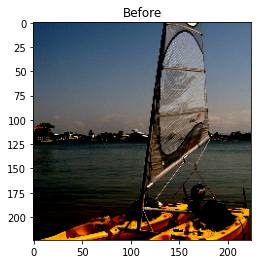

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


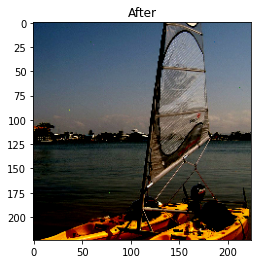


Final probability to be classified correctly: 0.47043562


 40%|███▉      | 281/708 [3:00:11<2:47:19, 23.51s/it]

Final probability to be classified as: 871  is  0.5155257
Queries 41
_________________________



 40%|███▉      | 282/708 [3:00:44<3:06:46, 26.31s/it]

 40%|███▉      | 283/708 [3:01:05<2:56:18, 24.89s/it]

 40%|████      | 284/708 [3:01:37<3:09:54, 26.87s/it]

 40%|████      | 285/708 [3:02:44<4:34:27, 38.93s/it]

 40%|████      | 286/708 [3:04:34<7:03:08, 60.16s/it]

 41%|████      | 287/708 [3:05:02<5:55:38, 50.68s/it]

 41%|████      | 288/708 [3:05:49<5:46:40, 49.53s/it]

 41%|████      | 289/708 [3:05:59<4:23:42, 37.76s/it]

 41%|████      | 290/708 [3:07:00<5:11:03, 44.65s/it]



___________________
Correct label: 14
Initial class: 14
Initial probability to be classified correctly: 0.9998087


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 84 generations
Label: 14 ; Prediction: 733
Fitness: 0.7465373


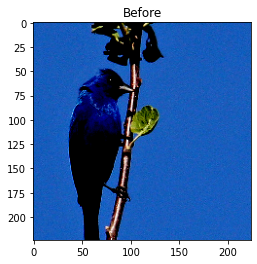

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


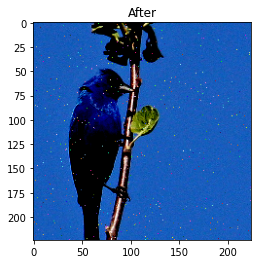


Final probability to be classified correctly: 0.2534627
Final probability to be classified as: 733  is  0.28472263
Queries 1681
_________________________



 41%|████      | 292/708 [3:10:02<7:49:49, 67.76s/it]

 41%|████▏     | 293/708 [3:10:15<5:54:31, 51.26s/it]

 42%|████▏     | 295/708 [3:12:17<5:50:45, 50.96s/it]

 42%|████▏     | 296/708 [3:12:31<4:33:34, 39.84s/it]

 42%|████▏     | 297/708 [3:13:39<5:30:02, 48.18s/it]

 42%|████▏     | 298/708 [3:14:04<4:41:02, 41.13s/it]

 42%|████▏     | 299/708 [3:14:24<3:58:00, 34.92s/it]

 42%|████▏     | 300/708 [3:16:06<6:14:40, 55.10s/it]



___________________
Correct label: 722
Initial class: 722
Initial probability to be classified correctly: 0.7982206


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 14 generations
Label: 722 ; Prediction: 462
Fitness: 0.7345264


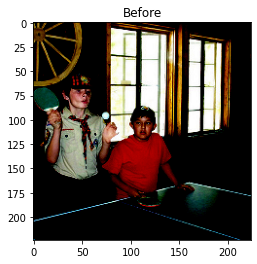

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


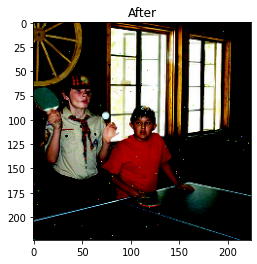


Final probability to be classified correctly: 0.26547357
Final probability to be classified as: 462  is  0.31386936
Queries 281
_________________________



 43%|████▎     | 302/708 [3:16:35<3:51:54, 34.27s/it]

 43%|████▎     | 303/708 [3:16:50<3:11:51, 28.42s/it]

 43%|████▎     | 304/708 [3:17:20<3:15:15, 29.00s/it]

 43%|████▎     | 305/708 [3:17:26<2:28:31, 22.11s/it]

 43%|████▎     | 306/708 [3:17:50<2:31:01, 22.54s/it]

 43%|████▎     | 307/708 [3:17:56<1:57:27, 17.58s/it]

 44%|████▎     | 308/708 [3:18:20<2:09:50, 19.48s/it]

 44%|████▎     | 309/708 [3:18:21<1:33:24, 14.05s/it]

 44%|████▍     | 310/708 [3:18:48<1:58:07, 17.81s/it]



___________________
Correct label: 350
Initial class: 350
Initial probability to be classified correctly: 0.99988747


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 68 generations
Label: 350 ; Prediction: 348
Fitness: 0.5054079


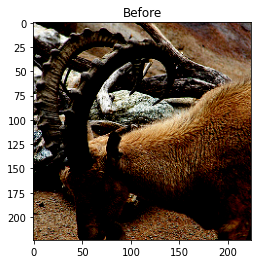

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


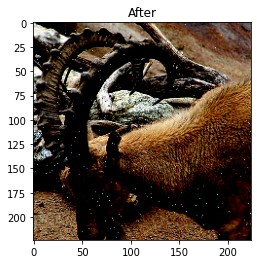


Final probability to be classified correctly: 0.49459204
Final probability to be classified as: 348  is  0.4987974
Queries 1361
_________________________



 44%|████▍     | 312/708 [3:20:12<3:01:02, 27.43s/it]

 44%|████▍     | 313/708 [3:20:54<3:28:51, 31.73s/it]

 44%|████▍     | 314/708 [3:21:26<3:29:30, 31.91s/it]

 44%|████▍     | 315/708 [3:21:38<2:49:42, 25.91s/it]

 45%|████▍     | 316/708 [3:22:23<3:26:29, 31.61s/it]

 45%|████▍     | 317/708 [3:22:25<2:28:32, 22.79s/it]

 45%|████▍     | 318/708 [3:23:29<3:47:47, 35.05s/it]

 45%|████▌     | 319/708 [3:23:56<3:31:47, 32.67s/it]

 45%|████▌     | 320/708 [3:25:54<6:16:38, 58.24s/it]



___________________
Correct label: 788
Initial class: 788
Initial probability to be classified correctly: 0.86611074


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 7 generations
Label: 788 ; Prediction: 413
Fitness: 0.64090574


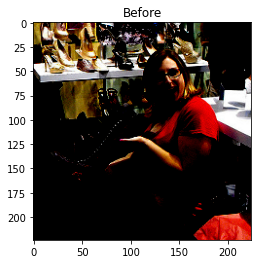

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


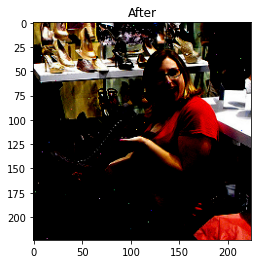


Final probability to be classified correctly: 0.35909423
Final probability to be classified as: 413  is  0.41589692
Queries 141
_________________________



 45%|████▌     | 322/708 [3:26:18<3:46:13, 35.16s/it]

 46%|████▌     | 323/708 [3:27:04<4:05:01, 38.19s/it]

 46%|████▌     | 324/708 [3:27:07<2:57:17, 27.70s/it]

 46%|████▌     | 325/708 [3:28:29<4:40:53, 44.00s/it]

 46%|████▌     | 326/708 [3:28:50<3:57:01, 37.23s/it]

 46%|████▌     | 327/708 [3:29:08<3:18:28, 31.26s/it]

 46%|████▋     | 328/708 [3:29:12<2:26:38, 23.15s/it]

 46%|████▋     | 329/708 [3:29:13<1:45:04, 16.63s/it]

 47%|████▋     | 330/708 [3:30:10<2:59:39, 28.52s/it]



___________________
Correct label: 141
Initial class: 141
Initial probability to be classified correctly: 0.9998938


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 85 generations
Label: 141 ; Prediction: 136
Fitness: 0.50580484


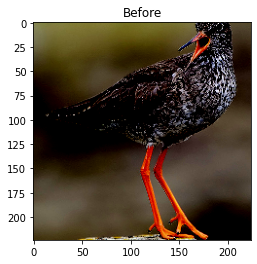

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


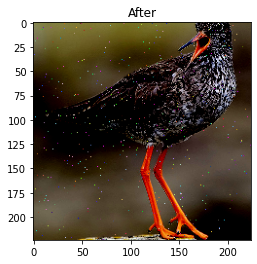


Final probability to be classified correctly: 0.49419516
Final probability to be classified as: 136  is  0.4995392
Queries 1701
_________________________



 47%|████▋     | 333/708 [3:34:26<6:18:22, 60.54s/it]

 47%|████▋     | 334/708 [3:34:40<4:50:23, 46.59s/it]

 47%|████▋     | 335/708 [3:35:16<4:28:37, 43.21s/it]

 48%|████▊     | 337/708 [3:37:39<5:29:10, 53.23s/it]

 48%|████▊     | 338/708 [3:37:59<4:26:11, 43.17s/it]

 48%|████▊     | 339/708 [3:38:02<3:11:41, 31.17s/it]

 48%|████▊     | 340/708 [3:38:32<3:08:46, 30.78s/it]



___________________
Correct label: 388
Initial class: 388
Initial probability to be classified correctly: 0.9725347


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 7 generations
Label: 388 ; Prediction: 296
Fitness: 0.6341393


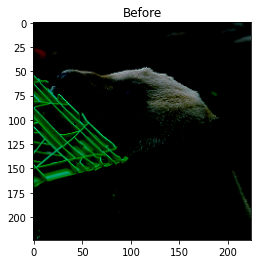

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


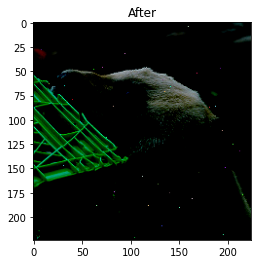


Final probability to be classified correctly: 0.3658607
Final probability to be classified as: 296  is  0.6307343
Queries 141
_________________________



 48%|████▊     | 342/708 [3:39:14<2:45:09, 27.07s/it]

 48%|████▊     | 343/708 [3:39:33<2:29:29, 24.57s/it]

 49%|████▊     | 344/708 [3:39:35<1:48:27, 17.88s/it]

 49%|████▊     | 345/708 [3:39:40<1:23:36, 13.82s/it]

 49%|████▉     | 346/708 [3:39:54<1:23:47, 13.89s/it]

 49%|████▉     | 347/708 [3:39:57<1:04:11, 10.67s/it]

 49%|████▉     | 348/708 [3:40:53<2:26:33, 24.43s/it]

 49%|████▉     | 349/708 [3:41:16<2:22:50, 23.87s/it]

 49%|████▉     | 350/708 [3:41:33<2:09:40, 21.73s/it]



___________________
Correct label: 376
Initial class: 376
Initial probability to be classified correctly: 0.9999025


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 42 generations
Label: 376 ; Prediction: 368
Fitness: 0.613489


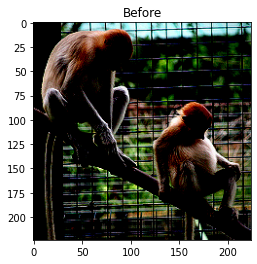

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


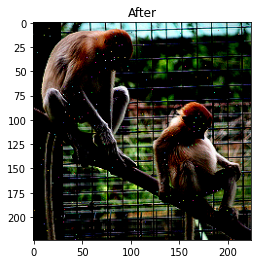


Final probability to be classified correctly: 0.38651103
Final probability to be classified as: 368  is  0.49515727
Queries 841
_________________________



 50%|████▉     | 352/708 [3:43:29<4:06:43, 41.58s/it]

 50%|████▉     | 353/708 [3:44:16<4:16:18, 43.32s/it]

 50%|█████     | 354/708 [3:44:31<3:25:49, 34.89s/it]

 50%|█████     | 355/708 [3:45:15<3:41:09, 37.59s/it]

 50%|█████     | 356/708 [3:45:23<2:48:31, 28.73s/it]

 50%|█████     | 357/708 [3:45:32<2:13:22, 22.80s/it]

 51%|█████     | 358/708 [3:46:08<2:35:26, 26.65s/it]

 51%|█████     | 359/708 [3:46:34<2:33:14, 26.35s/it]

 51%|█████     | 360/708 [3:47:32<3:27:58, 35.86s/it]



___________________
Correct label: 222
Initial class: 222
Initial probability to be classified correctly: 0.5715588


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 7 generations
Label: 222 ; Prediction: 258
Fitness: 0.8066219


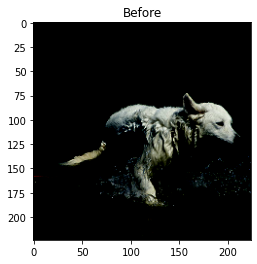

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


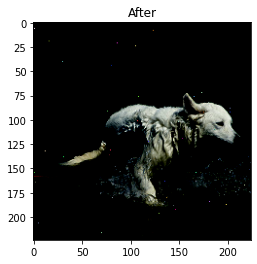


Final probability to be classified correctly: 0.19337806


 51%|█████     | 361/708 [3:47:39<2:38:35, 27.42s/it]

Final probability to be classified as: 258  is  0.25318784
Queries 141
_________________________



 51%|█████     | 362/708 [3:47:54<2:16:49, 23.73s/it]

 51%|█████▏    | 363/708 [3:48:00<1:45:51, 18.41s/it]

 51%|█████▏    | 364/708 [3:48:19<1:46:01, 18.49s/it]

 52%|█████▏    | 365/708 [3:48:20<1:16:13, 13.33s/it]

 52%|█████▏    | 366/708 [3:48:26<1:02:15, 10.92s/it]

 52%|█████▏    | 367/708 [3:49:29<2:32:01, 26.75s/it]

 52%|█████▏    | 368/708 [3:49:39<2:03:07, 21.73s/it]

 52%|█████▏    | 369/708 [3:49:42<1:30:07, 15.95s/it]

 52%|█████▏    | 370/708 [3:49:46<1:10:23, 12.50s/it]



___________________
Correct label: 219
Initial class: 219
Initial probability to be classified correctly: 0.9862292


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 32 generations
Label: 219 ; Prediction: 216
Fitness: 0.5248084


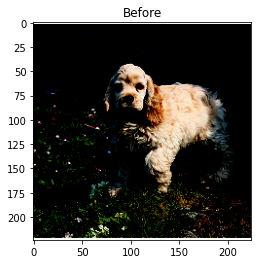

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


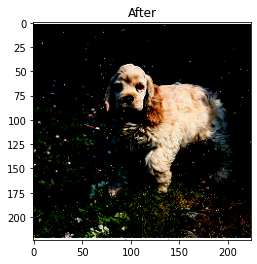


Final probability to be classified correctly: 0.47519156
Final probability to be classified as: 216  is  0.47665486
Queries 641
_________________________



 53%|█████▎    | 372/708 [3:50:58<2:17:45, 24.60s/it]

 53%|█████▎    | 373/708 [3:51:09<1:54:42, 20.54s/it]

 53%|█████▎    | 374/708 [3:51:44<2:19:25, 25.05s/it]

 53%|█████▎    | 375/708 [3:52:01<2:05:30, 22.61s/it]

 53%|█████▎    | 376/708 [3:52:59<3:02:50, 33.04s/it]

 53%|█████▎    | 377/708 [3:53:12<2:28:58, 27.01s/it]

 53%|█████▎    | 378/708 [3:53:21<2:00:11, 21.85s/it]

 54%|█████▎    | 379/708 [3:53:35<1:45:45, 19.29s/it]

 54%|█████▎    | 380/708 [3:53:39<1:20:33, 14.74s/it]



___________________
Correct label: 830
Initial class: 830
Initial probability to be classified correctly: 0.31351268


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 830 ; Prediction: 838
Fitness: 0.909696


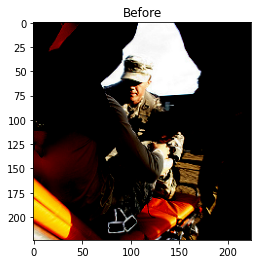

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


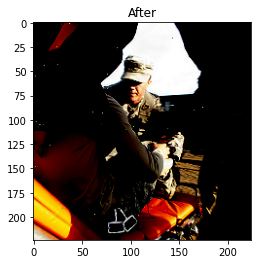


Final probability to be classified correctly: 0.09030399
Final probability to be classified as: 838  is  0.0923327
Queries 101
_________________________



 54%|█████▍    | 382/708 [3:54:53<2:37:06, 28.92s/it]

 54%|█████▍    | 383/708 [3:55:45<3:14:21, 35.88s/it]

 54%|█████▍    | 384/708 [3:56:23<3:16:34, 36.40s/it]

 54%|█████▍    | 385/708 [3:56:41<2:47:29, 31.11s/it]

 55%|█████▍    | 386/708 [3:56:52<2:14:30, 25.06s/it]

 55%|█████▍    | 387/708 [3:57:14<2:08:52, 24.09s/it]

 55%|█████▍    | 388/708 [3:57:30<1:55:07, 21.59s/it]

 55%|█████▍    | 389/708 [3:58:57<3:39:28, 41.28s/it]

 55%|█████▌    | 390/708 [3:58:59<2:35:21, 29.31s/it]



___________________
Correct label: 99
Initial class: 99
Initial probability to be classified correctly: 0.99993753
Final probability to be classified correctly: 0.58588886
Final probability to be classified as: 99  is  0.58588886
Queries 2001
_________________________



 55%|█████▌    | 392/708 [4:01:30<4:17:16, 48.85s/it]

 56%|█████▌    | 393/708 [4:01:49<3:28:49, 39.78s/it]

 56%|█████▌    | 394/708 [4:02:19<3:13:25, 36.96s/it]

 56%|█████▌    | 395/708 [4:02:41<2:48:47, 32.36s/it]

 56%|█████▌    | 396/708 [4:03:01<2:29:52, 28.82s/it]

 56%|█████▌    | 397/708 [4:03:04<1:48:09, 20.87s/it]

 56%|█████▌    | 398/708 [4:03:05<1:17:36, 15.02s/it]

 56%|█████▋    | 399/708 [4:03:36<1:42:00, 19.81s/it]

 56%|█████▋    | 400/708 [4:05:28<4:03:21, 47.41s/it]



___________________
Correct label: 705
Initial class: 705
Initial probability to be classified correctly: 0.88840777


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 14 generations
Label: 705 ; Prediction: 829
Fitness: 0.5844637


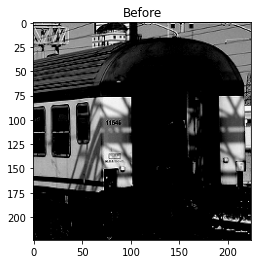

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


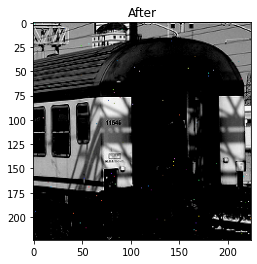


Final probability to be classified correctly: 0.4155363
Final probability to be classified as: 829  is  0.47984648
Queries 281
_________________________



 57%|█████▋    | 402/708 [4:06:33<3:31:05, 41.39s/it]

 57%|█████▋    | 403/708 [4:07:13<3:29:18, 41.17s/it]

 57%|█████▋    | 404/708 [4:07:15<2:28:10, 29.25s/it]

 57%|█████▋    | 405/708 [4:07:26<1:59:55, 23.75s/it]

 57%|█████▋    | 406/708 [4:07:32<1:32:46, 18.43s/it]

 57%|█████▋    | 407/708 [4:08:15<2:10:06, 25.94s/it]

 58%|█████▊    | 408/708 [4:09:02<2:40:12, 32.04s/it]

 58%|█████▊    | 410/708 [4:11:24<3:55:24, 47.40s/it]



___________________
Correct label: 874
Initial class: 874
Initial probability to be classified correctly: 0.99148494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 45 generations
Label: 874 ; Prediction: 705
Fitness: 0.5084517


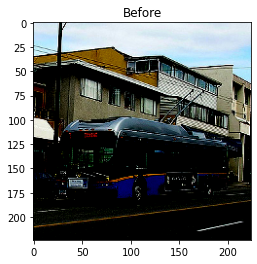

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


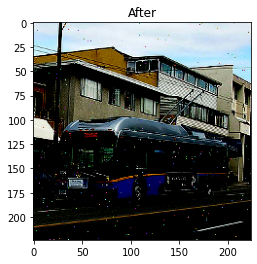


Final probability to be classified correctly: 0.49154827
Final probability to be classified as: 705  is  0.49841556
Queries 901
_________________________



 58%|█████▊    | 412/708 [4:12:12<2:46:13, 33.70s/it]

 58%|█████▊    | 413/708 [4:12:24<2:13:43, 27.20s/it]

 58%|█████▊    | 414/708 [4:13:01<2:26:55, 29.98s/it]

 59%|█████▊    | 415/708 [4:13:48<2:51:56, 35.21s/it]

 59%|█████▉    | 416/708 [4:14:16<2:40:28, 32.97s/it]

 59%|█████▉    | 417/708 [4:14:19<1:56:44, 24.07s/it]

 59%|█████▉    | 418/708 [4:14:47<2:02:11, 25.28s/it]

 59%|█████▉    | 419/708 [4:14:58<1:41:33, 21.09s/it]

 59%|█████▉    | 420/708 [4:15:01<1:14:07, 15.44s/it]



___________________
Correct label: 900
Initial class: 900
Initial probability to be classified correctly: 0.9999993
Final probability to be classified correctly: 0.98388565
Final probability to be classified as: 900  is  0.98388565
Queries 2001
_________________________



 60%|█████▉    | 422/708 [4:17:16<2:57:37, 37.26s/it]

 60%|█████▉    | 423/708 [4:17:24<2:15:20, 28.49s/it]

 60%|█████▉    | 424/708 [4:18:04<2:31:40, 32.04s/it]

 60%|██████    | 425/708 [4:18:06<1:47:50, 22.86s/it]

 60%|██████    | 426/708 [4:18:16<1:29:09, 18.97s/it]

 60%|██████    | 427/708 [4:18:44<1:41:45, 21.73s/it]

 60%|██████    | 428/708 [4:20:38<3:50:38, 49.42s/it]

 61%|██████    | 429/708 [4:20:42<2:46:47, 35.87s/it]

 61%|██████    | 430/708 [4:20:46<2:02:03, 26.34s/it]



___________________
Correct label: 162
Initial class: 162
Initial probability to be classified correctly: 0.869955


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 11 generations
Label: 162 ; Prediction: 208
Fitness: 0.6748744


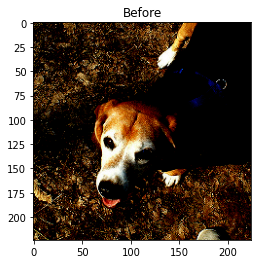

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


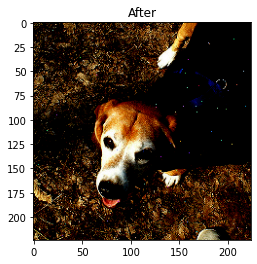


Final probability to be classified correctly: 0.3251256
Final probability to be classified as: 208  is  0.4068123
Queries 221
_________________________



 61%|██████    | 432/708 [4:21:23<1:44:51, 22.79s/it]

 61%|██████    | 433/708 [4:21:28<1:20:10, 17.49s/it]

 61%|██████▏   | 434/708 [4:21:47<1:23:02, 18.18s/it]

 61%|██████▏   | 435/708 [4:21:55<1:08:38, 15.09s/it]

 62%|██████▏   | 436/708 [4:22:34<1:39:51, 22.03s/it]

 62%|██████▏   | 437/708 [4:23:10<1:58:42, 26.28s/it]

 62%|██████▏   | 438/708 [4:23:31<1:51:54, 24.87s/it]

 62%|██████▏   | 439/708 [4:24:19<2:22:28, 31.78s/it]

 62%|██████▏   | 440/708 [4:25:45<3:34:27, 48.01s/it]



___________________
Correct label: 998
Initial class: 998
Initial probability to be classified correctly: 0.9795982


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 16 generations
Label: 998 ; Prediction: 987
Fitness: 0.68867487


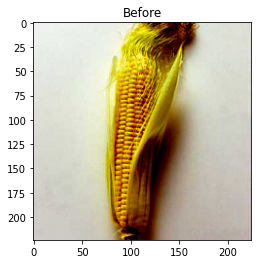

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


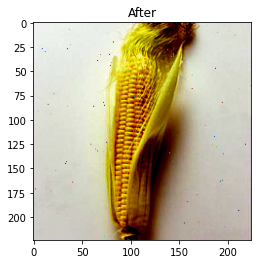


Final probability to be classified correctly: 0.31132513
Final probability to be classified as: 987  is  0.38108692
Queries 321
_________________________



 62%|██████▏   | 442/708 [4:26:05<2:04:49, 28.16s/it]

 63%|██████▎   | 443/708 [4:27:01<2:41:22, 36.54s/it]

 63%|██████▎   | 444/708 [4:27:19<2:15:34, 30.81s/it]

 63%|██████▎   | 445/708 [4:27:33<1:52:35, 25.69s/it]

 63%|██████▎   | 446/708 [4:27:36<1:22:54, 18.99s/it]

 63%|██████▎   | 447/708 [4:27:44<1:08:13, 15.69s/it]

 63%|██████▎   | 448/708 [4:28:12<1:24:11, 19.43s/it]

 63%|██████▎   | 449/708 [4:28:55<1:53:51, 26.38s/it]

 64%|██████▎   | 450/708 [4:29:26<1:59:55, 27.89s/it]



___________________
Correct label: 716
Initial class: 716
Initial probability to be classified correctly: 0.9604363


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 36 generations
Label: 716 ; Prediction: 912
Fitness: 0.50499266


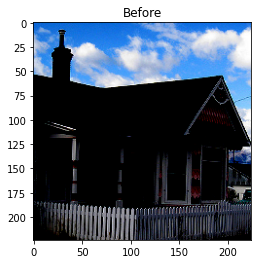

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


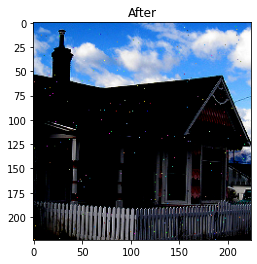


Final probability to be classified correctly: 0.49500734
Final probability to be classified as: 912  is  0.50190574
Queries 721
_________________________



 64%|██████▍   | 452/708 [4:30:50<2:31:13, 35.44s/it]

 64%|██████▍   | 453/708 [4:32:46<4:14:04, 59.78s/it]

 64%|██████▍   | 454/708 [4:33:35<3:59:28, 56.57s/it]

 64%|██████▍   | 456/708 [4:35:38<3:44:53, 53.55s/it]

 65%|██████▍   | 457/708 [4:35:42<2:42:09, 38.76s/it]

 65%|██████▍   | 458/708 [4:36:04<2:20:54, 33.82s/it]

 65%|██████▍   | 459/708 [4:37:47<3:46:06, 54.48s/it]

 65%|██████▍   | 460/708 [4:37:58<2:51:07, 41.40s/it]



___________________
Correct label: 632
Initial class: 632
Initial probability to be classified correctly: 0.9964496


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 33 generations
Label: 632 ; Prediction: 759
Fitness: 0.5453825


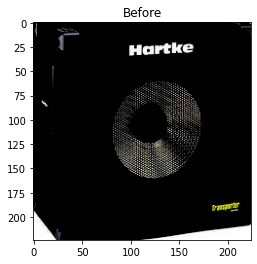

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


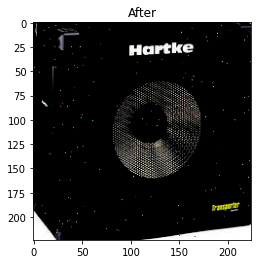


Final probability to be classified correctly: 0.45461747
Final probability to be classified as: 759  is  0.5129656
Queries 661
_________________________



 65%|██████▌   | 462/708 [4:38:43<2:07:08, 31.01s/it]

 65%|██████▌   | 463/708 [4:39:16<2:09:08, 31.63s/it]

 66%|██████▌   | 464/708 [4:39:21<1:36:07, 23.64s/it]

 66%|██████▌   | 465/708 [4:39:31<1:19:03, 19.52s/it]

 66%|██████▌   | 466/708 [4:40:09<1:40:42, 24.97s/it]

 66%|██████▌   | 467/708 [4:40:12<1:13:54, 18.40s/it]

 66%|██████▌   | 468/708 [4:40:44<1:30:06, 22.53s/it]

 66%|██████▌   | 469/708 [4:40:46<1:04:18, 16.14s/it]

 66%|██████▋   | 470/708 [4:40:48<47:25, 11.96s/it]  



___________________
Correct label: 10
Initial class: 10
Initial probability to be classified correctly: 0.84314847


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 7 generations
Label: 10 ; Prediction: 13
Fitness: 0.56754994


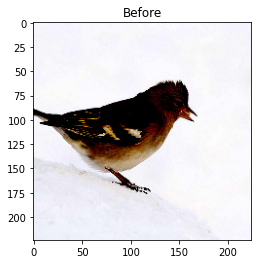

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


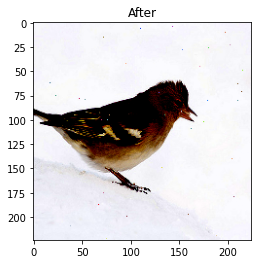


Final probability to be classified correctly: 0.43245003


 67%|██████▋   | 471/708 [4:40:55<42:02, 10.64s/it]

Final probability to be classified as: 13  is  0.5362705
Queries 141
_________________________



 67%|██████▋   | 472/708 [4:41:05<41:03, 10.44s/it]

 67%|██████▋   | 473/708 [4:41:13<37:53,  9.68s/it]

 67%|██████▋   | 474/708 [4:41:37<54:40, 14.02s/it]

 67%|██████▋   | 475/708 [4:41:42<43:58, 11.32s/it]

 67%|██████▋   | 476/708 [4:41:53<43:08, 11.16s/it]

 67%|██████▋   | 477/708 [4:41:59<36:54,  9.59s/it]

 68%|██████▊   | 478/708 [4:42:20<50:18, 13.12s/it]

 68%|██████▊   | 479/708 [4:42:36<52:35, 13.78s/it]

 68%|██████▊   | 480/708 [4:43:17<1:23:39, 22.02s/it]



___________________
Correct label: 763
Initial class: 763
Initial probability to be classified correctly: 0.45494008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 18 generations
Label: 763 ; Prediction: 477
Fitness: 0.8265359


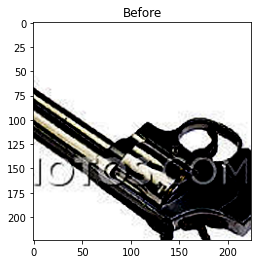

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


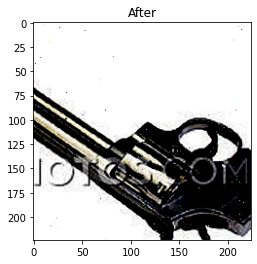


Final probability to be classified correctly: 0.17346412
Final probability to be classified as: 477  is  0.21728145
Queries 361
_________________________



 68%|██████▊   | 482/708 [4:43:42<1:02:56, 16.71s/it]

 68%|██████▊   | 483/708 [4:44:00<1:03:36, 16.96s/it]

 68%|██████▊   | 484/708 [4:44:24<1:11:14, 19.08s/it]

 69%|██████▊   | 485/708 [4:45:15<1:46:34, 28.68s/it]

 69%|██████▊   | 486/708 [4:46:20<2:26:16, 39.53s/it]

 69%|██████▉   | 487/708 [4:46:27<1:50:31, 30.01s/it]

 69%|██████▉   | 488/708 [4:46:49<1:40:42, 27.47s/it]

 69%|██████▉   | 489/708 [4:46:54<1:15:35, 20.71s/it]

 69%|██████▉   | 490/708 [4:47:55<1:58:49, 32.70s/it]



___________________
Correct label: 746
Initial class: 746
Initial probability to be classified correctly: 0.99999535
Final probability to be classified correctly: 0.47366452
Final probability to be classified as: 746  is  0.47366452
Queries 2001
_________________________



 69%|██████▉   | 492/708 [4:50:38<3:14:16, 53.97s/it]

 70%|██████▉   | 493/708 [4:51:02<2:41:15, 45.00s/it]

 70%|██████▉   | 494/708 [4:51:41<2:33:55, 43.16s/it]

 70%|███████   | 496/708 [4:54:32<3:38:31, 61.85s/it]

 70%|███████   | 499/708 [4:59:53<5:06:41, 88.04s/it]

 71%|███████   | 500/708 [5:00:07<3:48:49, 66.00s/it]



___________________
Correct label: 370
Initial class: 370
Initial probability to be classified correctly: 0.9849503


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 32 generations
Label: 370 ; Prediction: 371
Fitness: 0.5339983


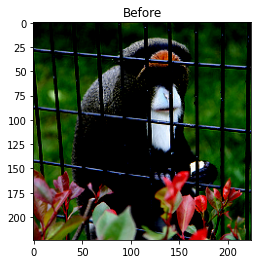

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


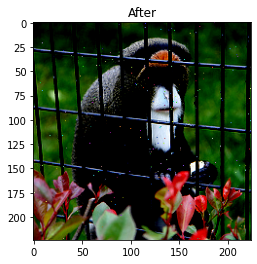


Final probability to be classified correctly: 0.4660017
Final probability to be classified as: 371  is  0.47242016
Queries 641
_________________________



 71%|███████   | 502/708 [5:00:48<2:22:42, 41.57s/it]

 71%|███████   | 503/708 [5:01:20<2:12:54, 38.90s/it]

 71%|███████   | 504/708 [5:01:25<1:36:48, 28.47s/it]

 71%|███████▏  | 505/708 [5:01:27<1:09:42, 20.60s/it]

 71%|███████▏  | 506/708 [5:01:40<1:01:52, 18.38s/it]

 72%|███████▏  | 507/708 [5:02:11<1:14:13, 22.16s/it]

 72%|███████▏  | 508/708 [5:02:12<53:00, 15.90s/it]  

 72%|███████▏  | 509/708 [5:02:52<1:16:25, 23.04s/it]

 72%|███████▏  | 510/708 [5:02:58<59:08, 17.92s/it]  



___________________
Correct label: 285
Initial class: 285
Initial probability to be classified correctly: 0.987457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 19 generations
Label: 285 ; Prediction: 364
Fitness: 0.64148724


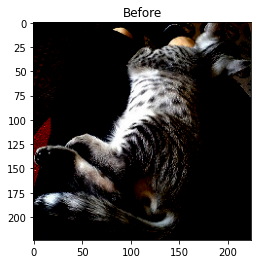

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


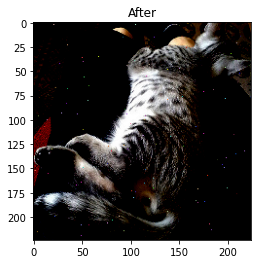


Final probability to be classified correctly: 0.35851273
Final probability to be classified as: 364  is  0.5313757
Queries 381
_________________________



 72%|███████▏  | 512/708 [5:03:38<1:02:52, 19.25s/it]

 72%|███████▏  | 513/708 [5:03:40<45:00, 13.85s/it]  

 73%|███████▎  | 514/708 [5:03:41<32:31, 10.06s/it]

 73%|███████▎  | 515/708 [5:04:42<1:21:48, 25.43s/it]

 73%|███████▎  | 516/708 [5:05:11<1:24:54, 26.53s/it]

 73%|███████▎  | 517/708 [5:05:51<1:36:48, 30.41s/it]

 73%|███████▎  | 518/708 [5:06:03<1:19:15, 25.03s/it]

 73%|███████▎  | 519/708 [5:07:07<1:55:47, 36.76s/it]

 73%|███████▎  | 520/708 [5:07:47<1:57:43, 37.57s/it]



___________________
Correct label: 728
Initial class: 728
Initial probability to be classified correctly: 0.99873847


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 22 generations
Label: 728 ; Prediction: 693
Fitness: 0.5190345


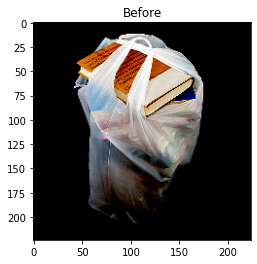

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


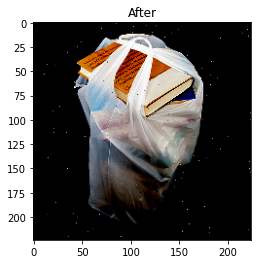


Final probability to be classified correctly: 0.4809655
Final probability to be classified as: 693  is  0.4890715
Queries 441
_________________________



 74%|███████▎  | 522/708 [5:08:50<1:49:51, 35.44s/it]

 74%|███████▍  | 523/708 [5:10:44<3:02:05, 59.06s/it]

 74%|███████▍  | 525/708 [5:13:06<3:04:13, 60.40s/it]

 74%|███████▍  | 526/708 [5:13:07<2:09:27, 42.68s/it]

 74%|███████▍  | 527/708 [5:13:54<2:12:18, 43.86s/it]

 75%|███████▍  | 528/708 [5:14:02<1:39:55, 33.31s/it]

 75%|███████▍  | 529/708 [5:14:19<1:24:26, 28.30s/it]

 75%|███████▍  | 530/708 [5:14:38<1:15:53, 25.58s/it]



___________________
Correct label: 486
Initial class: 486
Initial probability to be classified correctly: 0.9999827


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 71 generations
Label: 486 ; Prediction: 889
Fitness: 0.5083697


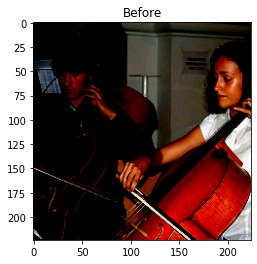

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


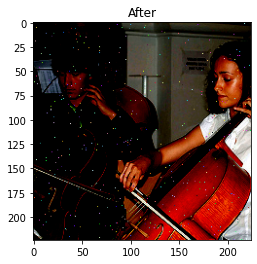


Final probability to be classified correctly: 0.49163032
Final probability to be classified as: 889  is  0.5083686
Queries 1421
_________________________



 75%|███████▌  | 532/708 [5:15:59<1:27:07, 29.70s/it]

 75%|███████▌  | 533/708 [5:16:26<1:24:17, 28.90s/it]

 75%|███████▌  | 534/708 [5:17:11<1:37:57, 33.78s/it]

 76%|███████▌  | 535/708 [5:17:25<1:20:17, 27.85s/it]

 76%|███████▌  | 536/708 [5:17:26<57:01, 19.89s/it]  

 76%|███████▌  | 537/708 [5:18:00<1:08:37, 24.08s/it]

 76%|███████▌  | 538/708 [5:18:42<1:22:58, 29.29s/it]

 76%|███████▌  | 539/708 [5:19:38<1:45:31, 37.46s/it]

 76%|███████▋  | 540/708 [5:20:02<1:33:39, 33.45s/it]



___________________
Correct label: 202
Initial class: 202
Initial probability to be classified correctly: 0.98580927


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 29 generations
Label: 202 ; Prediction: 262
Fitness: 0.5591593


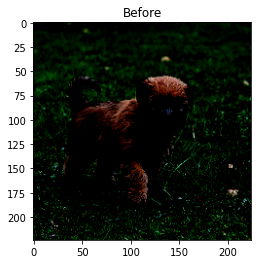

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


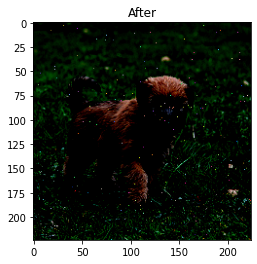


Final probability to be classified correctly: 0.4408407
Final probability to be classified as: 262  is  0.48131722
Queries 581
_________________________



 77%|███████▋  | 542/708 [5:20:48<1:16:17, 27.57s/it]

 77%|███████▋  | 544/708 [5:24:40<3:16:40, 71.96s/it]

 77%|███████▋  | 545/708 [5:24:59<2:32:38, 56.19s/it]

 77%|███████▋  | 546/708 [5:25:27<2:08:32, 47.61s/it]

 77%|███████▋  | 547/708 [5:25:30<1:31:58, 34.28s/it]

 77%|███████▋  | 548/708 [5:25:57<1:25:36, 32.10s/it]

 78%|███████▊  | 549/708 [5:26:09<1:09:36, 26.27s/it]

 78%|███████▊  | 550/708 [5:28:06<2:20:33, 53.37s/it]



___________________
Correct label: 514
Initial class: 514
Initial probability to be classified correctly: 0.99768233


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 26 generations
Label: 514 ; Prediction: 797
Fitness: 0.5523539


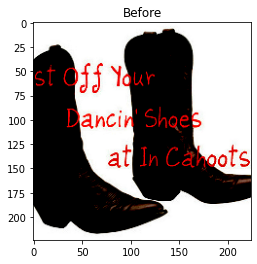

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


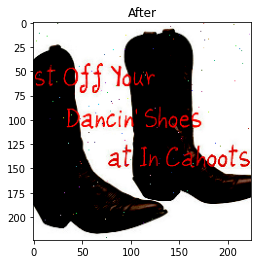


Final probability to be classified correctly: 0.44764608
Final probability to be classified as: 797  is  0.5342367
Queries 521
_________________________



 78%|███████▊  | 552/708 [5:28:34<1:24:07, 32.35s/it]

 78%|███████▊  | 553/708 [5:28:40<1:02:33, 24.21s/it]

 78%|███████▊  | 554/708 [5:29:03<1:01:29, 23.96s/it]

 78%|███████▊  | 555/708 [5:29:04<43:45, 17.16s/it]  

 79%|███████▊  | 556/708 [5:29:07<32:48, 12.95s/it]

 79%|███████▊  | 557/708 [5:31:02<1:49:09, 43.37s/it]

 79%|███████▉  | 558/708 [5:33:00<2:44:51, 65.95s/it]

 79%|███████▉  | 559/708 [5:33:03<1:56:20, 46.85s/it]

 79%|███████▉  | 560/708 [5:33:58<2:02:04, 49.49s/it]



___________________
Correct label: 578
Initial class: 578
Initial probability to be classified correctly: 0.34551182


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 1 generations
Label: 578 ; Prediction: 869
Fitness: 0.7923777


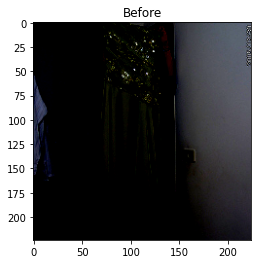

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


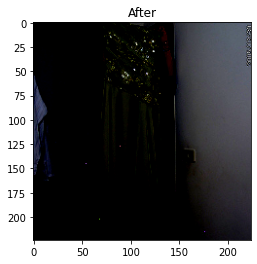


Final probability to be classified correctly: 0.20762226
Final probability to be classified as: 869  is  0.6019897
Queries 21
_________________________



 79%|███████▉  | 562/708 [5:34:27<1:19:37, 32.72s/it]

 80%|███████▉  | 563/708 [5:34:56<1:16:12, 31.53s/it]

 80%|███████▉  | 564/708 [5:35:11<1:04:06, 26.71s/it]

 80%|███████▉  | 565/708 [5:35:15<46:52, 19.67s/it]  

 80%|███████▉  | 566/708 [5:35:39<49:46, 21.03s/it]

 80%|████████  | 567/708 [5:35:46<39:28, 16.80s/it]

 80%|████████  | 568/708 [5:35:48<29:01, 12.44s/it]

 80%|████████  | 569/708 [5:36:21<43:01, 18.57s/it]

 81%|████████  | 570/708 [5:37:42<1:25:52, 37.34s/it]



___________________
Correct label: 874
Initial class: 874
Initial probability to be classified correctly: 0.9907414


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 59 generations
Label: 874 ; Prediction: 555
Fitness: 0.50854504


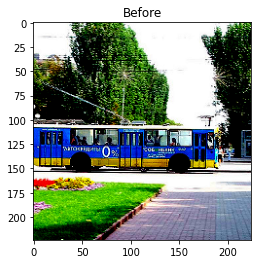

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


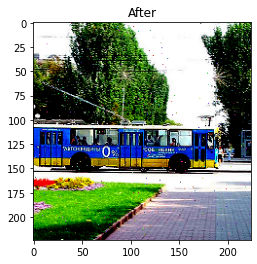


Final probability to be classified correctly: 0.49145493
Final probability to be classified as: 555  is  0.49298146
Queries 1181
_________________________



 81%|████████  | 572/708 [5:39:53<1:57:19, 51.76s/it]

 81%|████████  | 573/708 [5:41:10<2:13:25, 59.30s/it]

 81%|████████  | 574/708 [5:41:44<1:55:44, 51.83s/it]

 81%|████████  | 575/708 [5:41:52<1:25:47, 38.70s/it]

 81%|████████▏ | 576/708 [5:42:34<1:27:14, 39.65s/it]

 81%|████████▏ | 577/708 [5:43:19<1:30:21, 41.39s/it]

 82%|████████▏ | 578/708 [5:43:23<1:04:58, 29.99s/it]

 82%|████████▏ | 579/708 [5:43:25<46:34, 21.66s/it]  

 82%|████████▏ | 580/708 [5:43:42<42:58, 20.14s/it]



___________________
Correct label: 663
Initial class: 663
Initial probability to be classified correctly: 0.9147515


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 18 generations
Label: 663 ; Prediction: 497
Fitness: 0.5516578


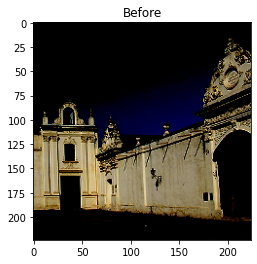

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


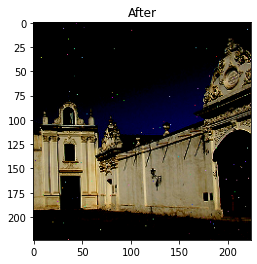


Final probability to be classified correctly: 0.44834223
Final probability to be classified as: 497  is  0.5185746
Queries 361
_________________________



 82%|████████▏ | 583/708 [5:46:09<1:18:08, 37.51s/it]

 82%|████████▏ | 584/708 [5:46:15<57:56, 28.03s/it]  

 83%|████████▎ | 585/708 [5:47:31<1:26:55, 42.40s/it]

 83%|████████▎ | 586/708 [5:49:00<1:54:45, 56.44s/it]

 83%|████████▎ | 587/708 [5:49:47<1:48:06, 53.61s/it]

 83%|████████▎ | 588/708 [5:49:50<1:16:56, 38.47s/it]

 83%|████████▎ | 589/708 [5:49:55<56:20, 28.41s/it]  

 83%|████████▎ | 590/708 [5:50:38<1:04:07, 32.60s/it]



___________________
Correct label: 916
Initial class: 916
Initial probability to be classified correctly: 0.9999429


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 77 generations
Label: 916 ; Prediction: 922
Fitness: 0.5213468


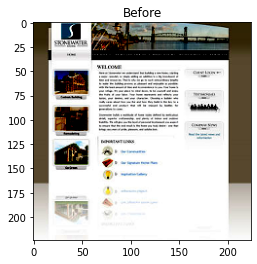

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


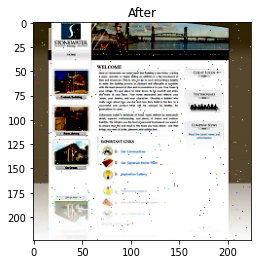


Final probability to be classified correctly: 0.47865322
Final probability to be classified as: 922  is  0.514706
Queries 1541
_________________________



 84%|████████▎ | 592/708 [5:52:14<1:11:11, 36.82s/it]

 84%|████████▍ | 593/708 [5:52:18<51:44, 27.00s/it]  

 84%|████████▍ | 594/708 [5:52:30<42:58, 22.62s/it]

 84%|████████▍ | 595/708 [5:52:36<33:12, 17.63s/it]

 84%|████████▍ | 596/708 [5:52:48<29:35, 15.85s/it]

 84%|████████▍ | 597/708 [5:53:08<31:42, 17.14s/it]

 84%|████████▍ | 598/708 [5:53:45<42:27, 23.16s/it]

 85%|████████▍ | 599/708 [5:54:15<45:57, 25.29s/it]

 85%|████████▍ | 600/708 [5:54:32<40:40, 22.60s/it]



___________________
Correct label: 822
Initial class: 822
Initial probability to be classified correctly: 0.9613949


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 30 generations
Label: 822 ; Prediction: 869
Fitness: 0.82279


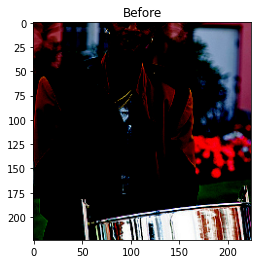

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


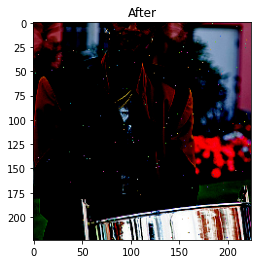


Final probability to be classified correctly: 0.17720996
Final probability to be classified as: 869  is  0.18003596
Queries 601
_________________________



 85%|████████▌ | 602/708 [5:55:19<39:42, 22.48s/it]

 85%|████████▌ | 603/708 [5:55:21<28:40, 16.38s/it]

 85%|████████▌ | 604/708 [5:56:39<1:00:47, 35.07s/it]

 85%|████████▌ | 605/708 [5:58:05<1:26:00, 50.11s/it]

 86%|████████▌ | 606/708 [5:59:00<1:28:03, 51.79s/it]

 86%|████████▌ | 607/708 [6:00:24<1:43:03, 61.22s/it]

 86%|████████▌ | 608/708 [6:00:25<1:12:04, 43.24s/it]

 86%|████████▌ | 609/708 [6:01:29<1:21:51, 49.61s/it]

 86%|████████▌ | 610/708 [6:01:37<1:00:31, 37.05s/it]



___________________
Correct label: 81
Initial class: 81
Initial probability to be classified correctly: 0.99989307


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 74 generations
Label: 81 ; Prediction: 139
Fitness: 0.52206635


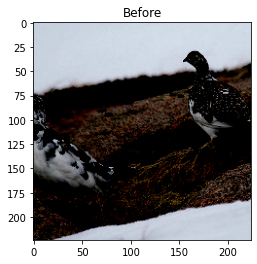

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


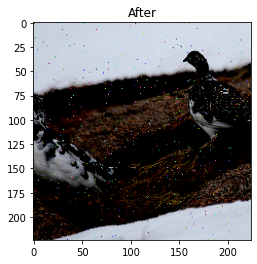


Final probability to be classified correctly: 0.47793365
Final probability to be classified as: 139  is  0.51413566
Queries 1481
_________________________



 86%|████████▋ | 612/708 [6:03:53<1:22:21, 51.48s/it]

 87%|████████▋ | 613/708 [6:04:29<1:13:58, 46.72s/it]

 87%|████████▋ | 614/708 [6:04:44<58:26, 37.31s/it]  

 87%|████████▋ | 615/708 [6:05:20<56:58, 36.76s/it]

 87%|████████▋ | 616/708 [6:05:37<47:25, 30.93s/it]

 87%|████████▋ | 617/708 [6:05:53<40:20, 26.60s/it]

 87%|████████▋ | 618/708 [6:07:32<1:12:30, 48.34s/it]

 87%|████████▋ | 619/708 [6:08:08<1:06:04, 44.55s/it]

 88%|████████▊ | 620/708 [6:08:58<1:07:42, 46.17s/it]



___________________
Correct label: 12
Initial class: 12
Initial probability to be classified correctly: 0.82481676


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 12 generations
Label: 12 ; Prediction: 85
Fitness: 0.69579005


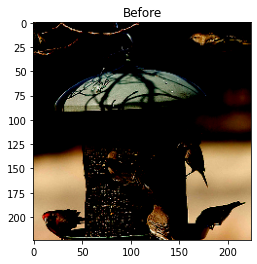

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


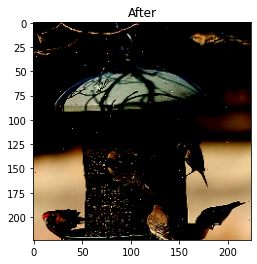


Final probability to be classified correctly: 0.30420992
Final probability to be classified as: 85  is  0.32136118
Queries 241
_________________________



 88%|████████▊ | 622/708 [6:09:20<40:08, 28.00s/it]  

 88%|████████▊ | 623/708 [6:10:41<1:02:11, 43.90s/it]

 88%|████████▊ | 624/708 [6:11:04<52:52, 37.77s/it]  

 88%|████████▊ | 625/708 [6:12:35<1:14:27, 53.83s/it]

 88%|████████▊ | 626/708 [6:13:10<1:05:40, 48.06s/it]

 89%|████████▊ | 627/708 [6:13:35<55:23, 41.03s/it]  

 89%|████████▊ | 628/708 [6:14:01<49:01, 36.77s/it]

 89%|████████▉ | 629/708 [6:14:10<37:19, 28.35s/it]

 89%|████████▉ | 630/708 [6:15:18<52:14, 40.19s/it]



___________________
Correct label: 940
Initial class: 940
Initial probability to be classified correctly: 0.977214


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 17 generations
Label: 940 ; Prediction: 961
Fitness: 0.6051508


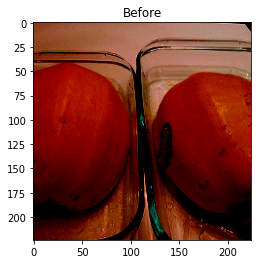

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


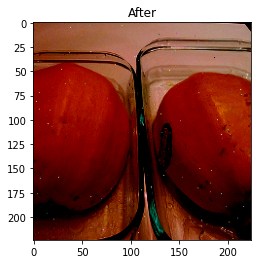


Final probability to be classified correctly: 0.39484915
Final probability to be classified as: 961  is  0.41337478
Queries 341
_________________________



 89%|████████▉ | 632/708 [6:15:48<34:28, 27.21s/it]

 89%|████████▉ | 633/708 [6:16:23<36:57, 29.57s/it]

 90%|████████▉ | 634/708 [6:16:49<34:55, 28.31s/it]

 90%|████████▉ | 635/708 [6:16:58<27:36, 22.70s/it]

 90%|████████▉ | 636/708 [6:17:20<27:06, 22.58s/it]

 90%|████████▉ | 637/708 [6:17:46<27:39, 23.38s/it]

 90%|█████████ | 638/708 [6:18:05<25:46, 22.09s/it]

 90%|█████████ | 639/708 [6:18:18<22:29, 19.55s/it]

 90%|█████████ | 640/708 [6:18:48<25:26, 22.45s/it]



___________________
Correct label: 508
Initial class: 508
Initial probability to be classified correctly: 0.91818744


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 28 generations
Label: 508 ; Prediction: 918
Fitness: 0.6514398


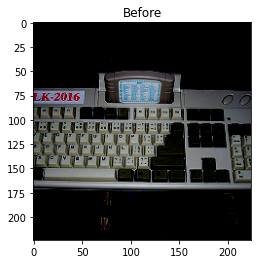

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


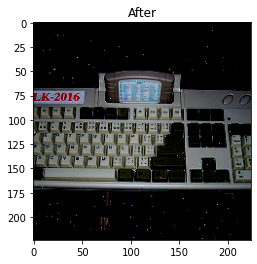


Final probability to be classified correctly: 0.3485602
Final probability to be classified as: 918  is  0.37784258
Queries 561
_________________________



 91%|█████████ | 642/708 [6:19:48<29:08, 26.50s/it]

 91%|█████████ | 643/708 [6:20:08<26:36, 24.56s/it]

 91%|█████████ | 644/708 [6:20:26<24:09, 22.65s/it]

 91%|█████████ | 645/708 [6:21:10<30:42, 29.24s/it]

 91%|█████████ | 646/708 [6:21:13<21:50, 21.14s/it]

 91%|█████████▏| 647/708 [6:21:24<18:36, 18.30s/it]

 92%|█████████▏| 648/708 [6:21:29<14:14, 14.25s/it]

 92%|█████████▏| 649/708 [6:21:31<10:27, 10.64s/it]

 92%|█████████▏| 650/708 [6:22:07<17:34, 18.19s/it]



___________________
Correct label: 595
Initial class: 595
Initial probability to be classified correctly: 0.9475555


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 27 generations
Label: 595 ; Prediction: 856
Fitness: 0.50924695


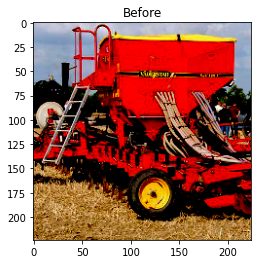

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


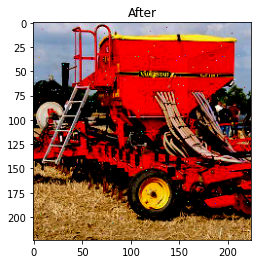


Final probability to be classified correctly: 0.49075308
Final probability to be classified as: 856  is  0.49953112
Queries 541
_________________________



 92%|█████████▏| 652/708 [6:23:25<27:53, 29.88s/it]

 92%|█████████▏| 653/708 [6:23:28<20:02, 21.86s/it]

 92%|█████████▏| 654/708 [6:23:42<17:24, 19.33s/it]

 93%|█████████▎| 655/708 [6:24:00<16:47, 19.00s/it]

 93%|█████████▎| 656/708 [6:25:48<39:34, 45.66s/it]

 93%|█████████▎| 657/708 [6:26:53<43:40, 51.38s/it]

 93%|█████████▎| 658/708 [6:27:18<36:23, 43.67s/it]

 93%|█████████▎| 659/708 [6:27:24<26:16, 32.17s/it]

 93%|█████████▎| 660/708 [6:27:57<25:56, 32.42s/it]



___________________
Correct label: 517
Initial class: 517
Initial probability to be classified correctly: 0.9884444


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 36 generations
Label: 517 ; Prediction: 557
Fitness: 0.60311776


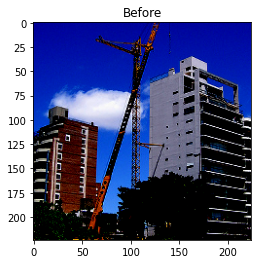

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


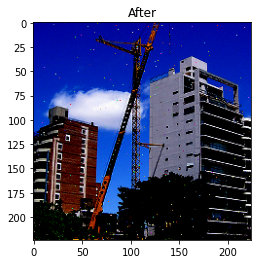


Final probability to be classified correctly: 0.39688224
Final probability to be classified as: 557  is  0.43223512
Queries 721
_________________________



 94%|█████████▎| 662/708 [6:28:59<23:59, 31.29s/it]

 94%|█████████▎| 663/708 [6:29:13<19:37, 26.16s/it]

 94%|█████████▍| 664/708 [6:29:16<14:06, 19.24s/it]

 94%|█████████▍| 666/708 [6:32:13<36:10, 51.69s/it]

 94%|█████████▍| 667/708 [6:32:24<26:53, 39.35s/it]

 94%|█████████▍| 668/708 [6:33:16<28:45, 43.13s/it]

 94%|█████████▍| 669/708 [6:33:24<21:17, 32.76s/it]

 95%|█████████▍| 670/708 [6:33:51<19:38, 31.02s/it]



___________________
Correct label: 930
Initial class: 930
Initial probability to be classified correctly: 0.99917465


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 28 generations
Label: 930 ; Prediction: 961
Fitness: 0.5374026


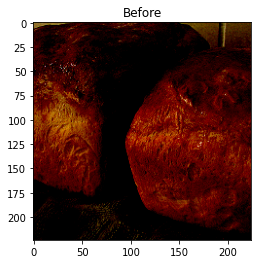

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


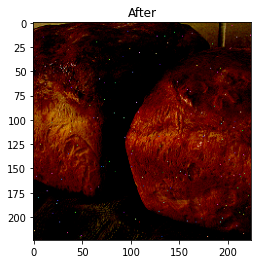


Final probability to be classified correctly: 0.46259743
Final probability to be classified as: 961  is  0.53561014
Queries 561
_________________________



 95%|█████████▍| 672/708 [6:35:54<29:47, 49.65s/it]

 95%|█████████▌| 673/708 [6:36:37<27:42, 47.49s/it]

 95%|█████████▌| 674/708 [6:36:50<21:08, 37.30s/it]

 95%|█████████▌| 675/708 [6:37:30<20:50, 37.91s/it]

 95%|█████████▌| 676/708 [6:39:05<29:22, 55.08s/it]

 96%|█████████▌| 677/708 [6:40:17<31:04, 60.16s/it]

 96%|█████████▌| 678/708 [6:40:50<26:06, 52.21s/it]

 96%|█████████▌| 679/708 [6:42:00<27:47, 57.51s/it]

 96%|█████████▌| 680/708 [6:42:46<25:08, 53.87s/it]



___________________
Correct label: 320
Initial class: 320
Initial probability to be classified correctly: 0.7709885


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 19 generations
Label: 320 ; Prediction: 319
Fitness: 0.5589856


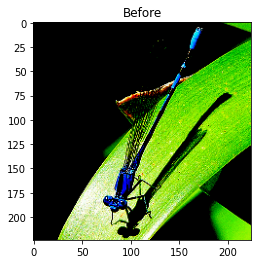

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


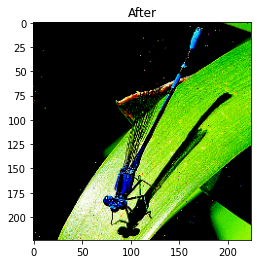


Final probability to be classified correctly: 0.4410144
Final probability to be classified as: 319  is  0.55545026
Queries 381
_________________________



 96%|█████████▋| 682/708 [6:43:33<16:50, 38.85s/it]

 96%|█████████▋| 683/708 [6:43:42<12:32, 30.08s/it]

 97%|█████████▋| 684/708 [6:43:44<08:35, 21.46s/it]

 97%|█████████▋| 685/708 [6:43:45<05:54, 15.42s/it]

 97%|█████████▋| 686/708 [6:44:01<05:45, 15.70s/it]

 97%|█████████▋| 687/708 [6:44:35<07:20, 21.00s/it]

 97%|█████████▋| 688/708 [6:45:00<07:27, 22.38s/it]

 97%|█████████▋| 689/708 [6:45:08<05:42, 18.01s/it]

 97%|█████████▋| 690/708 [6:45:15<04:24, 14.71s/it]



___________________
Correct label: 921
Initial class: 921
Initial probability to be classified correctly: 0.8946707


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 40 generations
Label: 921 ; Prediction: 608
Fitness: 0.86629176


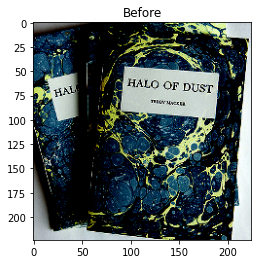

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


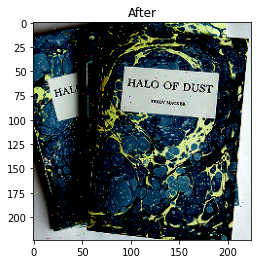


Final probability to be classified correctly: 0.13370822
Final probability to be classified as: 608  is  0.1373664
Queries 801
_________________________



 98%|█████████▊| 692/708 [6:47:26<11:26, 42.93s/it]

 98%|█████████▊| 693/708 [6:48:13<11:03, 44.21s/it]

 98%|█████████▊| 694/708 [6:48:20<07:42, 33.03s/it]

 98%|█████████▊| 695/708 [6:48:34<05:56, 27.40s/it]

 98%|█████████▊| 696/708 [6:48:37<03:57, 19.81s/it]

 98%|█████████▊| 697/708 [6:49:51<06:39, 36.35s/it]

 99%|█████████▊| 698/708 [6:51:03<07:48, 46.89s/it]

 99%|█████████▊| 699/708 [6:51:43<06:43, 44.82s/it]

 99%|█████████▉| 700/708 [6:51:48<04:22, 32.83s/it]



___________________
Correct label: 161
Initial class: 161
Initial probability to be classified correctly: 0.79482615


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 161 ; Prediction: 162
Fitness: 0.57663035


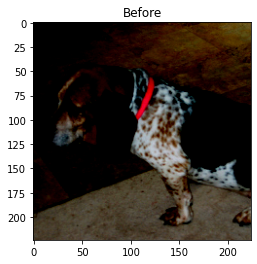

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


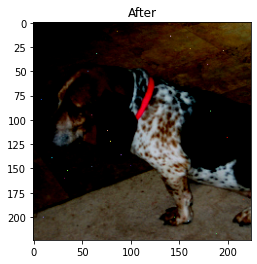


Final probability to be classified correctly: 0.42336965
Final probability to be classified as: 162  is  0.5043824
Queries 101
_________________________



 99%|█████████▉| 702/708 [6:51:59<01:52, 18.78s/it]

100%|█████████▉| 705/708 [6:56:06<02:34, 51.54s/it]

100%|█████████▉| 706/708 [6:56:14<01:16, 38.36s/it]

100%|█████████▉| 707/708 [6:56:16<00:27, 27.50s/it]

100%|██████████| 708/708 [6:56:19<00:00, 35.28s/it]

In [17]:
importlib.reload(EvoStrategy)
from tqdm import tqdm
perturbed_images_bf = 0
adv_evo_strategy_bf = {}
for index in tqdm(range(len(x_val_sample))):
    if index % 10 == 0:
        verbose = True
    else:
        verbose = False
    img = x_val_sample[index]
    label = np.argmax(y_val_one_hot_sample[index])
    adv_evo_strategy_bf[index] = EvoStrategy.AdversarialPerturbationBFStraegy(
        model=model,
        img=img,
        label=label,
        generation_size=20, 
        one_step_perturbation_pixel_count=5,
        verbose=verbose
    )
    no_steps_bf = adv_evo_strategy_bf[index].run_adversarial_attack(steps=100)
    if adv_evo_strategy_bf[index].stop_criterion() and no_steps_bf > 0:
        perturbed_images_bf += 1
    adv_evo_strategy_bf[index].active_generation = []
    adv_evo_strategy_bf[index].fitness_scores = []
    gc.collect()

In [18]:
count_q_bf = 0
sum_q_bf = 0
for index in tqdm(range(len(x_val_sample))):
    if(adv_evo_strategy_bf[index].queries > 1):
        count_q_bf +=1
        sum_q_bf += adv_evo_strategy_bf[index].queries
        
print("Average queries for EVO algo:", sum_q_bf/count_q_bf)
print("Total count of perturbed images (classified correctly initially):", perturbed_images_bf)

100%|██████████| 708/708 [00:00<00:00, 699379.94it/s]

Average queries for EVO algo: 652.4689265536723
Total count of perturbed images (classified correctly initially): 667


In [20]:
671/len(x_val_sample)

0.9477401129943502

In [142]:
import math
from tqdm import tqdm
l2_dists = []
for index_diff in tqdm(range(50)):
    diff = np.abs(adv_evo_strategy[index_diff].get_best_candidate() - x_val_sample[index_diff])
#     diff = np.reshape(diff, (32, 32, 3))
    l2_dist = math.sqrt(np.sum(np.reshape(diff, (-1))**2))
    l2_dists.append(l2_dist)
#     print("L2 distance:", math.sqrt(np.sum(np.reshape(diff, (-1))**2)))
#     plt.imshow(np.reshape(adv_evo_strategy[index_diff].get_best_candidate(), (28, 28)))
#     plt.show()
#     print("Prediction:", model.predict(np.array([adv_evo_strategy[index_diff].get_best_candidate()])))

100%|██████████| 50/50 [00:00<00:00, 4127.44it/s]


In [145]:
np.shape(x_val_sample[0])

(224, 224, 3)

In [148]:
np.mean(l2_dists)/(255 * 224 * 224)

0.00018004952445710486


0

___________________
Correct label: 65
Initial class: 65
Initial probability to be classified correctly: 0.81139535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 13 generations
Label: 65 ; Prediction: 62
Fitness: 0.6475125


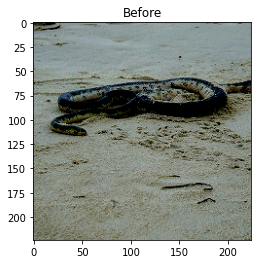

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


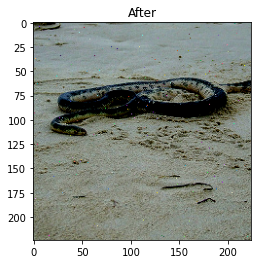


Final probability to be classified correctly: 0.3524875
Final probability to be classified as: 62  is  0.3660497
_________________________


1

___________________
Correct label: 809
Initial class: 809
Initial probability to be classified correctly: 0.6323444


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 809 ; Prediction: 968
Fitness: 0.5512551


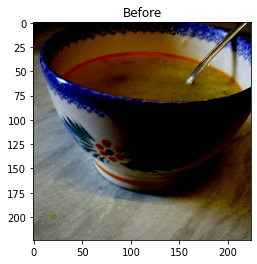

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


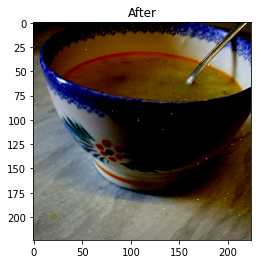


Final probability to be classified correctly: 0.4487449
Final probability to be classified as: 968  is  0.4646953
_________________________


2

___________________
Correct label: 334
Initial class: 334
Initial probability to be classified correctly: 0.9900097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 26 generations
Label: 334 ; Prediction: 102
Fitness: 0.62189996


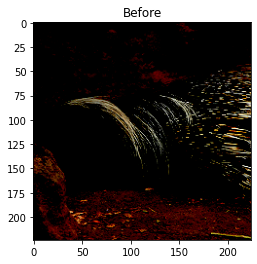

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


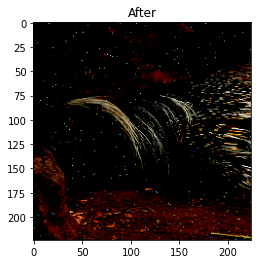


Final probability to be classified correctly: 0.37810004
Final probability to be classified as: 102  is  0.4365823
_________________________


3

___________________
Correct label: 674
Initial class: 674
Initial probability to be classified correctly: 0.99953544


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 45 generations
Label: 674 ; Prediction: 341
Fitness: 0.64097697


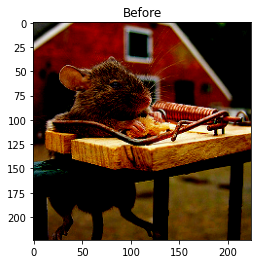

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


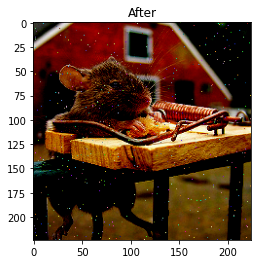


Final probability to be classified correctly: 0.35902303
Final probability to be classified as: 341  is  0.39935017
_________________________


4

___________________
Correct label: 109
Initial class: 109
Initial probability to be classified correctly: 0.99999917
Final probability to be classified correctly: 0.9969874
Final probability to be classified as: 109  is  0.9969874
_________________________


5

___________________
Correct label: 286
Initial class: 286
Initial probability to be classified correctly: 0.9993394
Final probability to be classified correctly: 0.83035713
Final probability to be classified as: 286  is  0.83035713
_________________________


6

___________________
Correct label: 370
Initial class: 370
Initial probability to be classified correctly: 0.91297334


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 18 generations
Label: 370 ; Prediction: 371
Fitness: 0.53397286


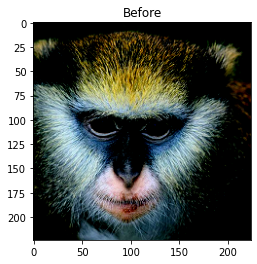

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


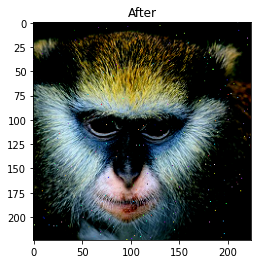


Final probability to be classified correctly: 0.46602717
Final probability to be classified as: 371  is  0.53255695
_________________________


7

___________________
Correct label: 757
Initial class: 757
Initial probability to be classified correctly: 0.99768686


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 19 generations
Label: 757 ; Prediction: 407
Fitness: 0.56747216


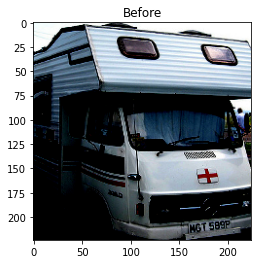

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


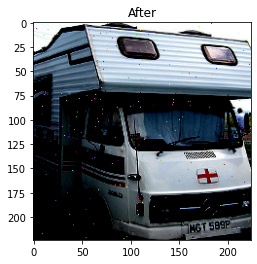


Final probability to be classified correctly: 0.43252784
Final probability to be classified as: 407  is  0.5572347
_________________________


8

___________________
Correct label: 595
Initial class: 595
Initial probability to be classified correctly: 0.9969524


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 50 generations
Label: 595 ; Prediction: 984
Fitness: 0.7955917


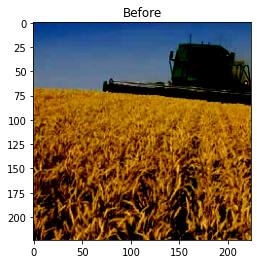

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


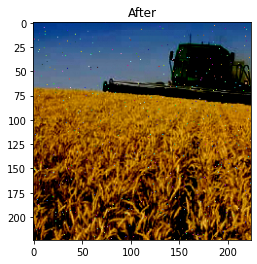


Final probability to be classified correctly: 0.20440832
Final probability to be classified as: 984  is  0.25831652
_________________________


9

___________________
Correct label: 147
Initial class: 147
Initial probability to be classified correctly: 0.999864
Final probability to be classified correctly: 0.6659619
Final probability to be classified as: 147  is  0.6659619
_________________________


10

___________________
Correct label: 478
Initial class: 478
Initial probability to be classified correctly: 0.95922863


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 478 ; Prediction: 553
Fitness: 0.6143569


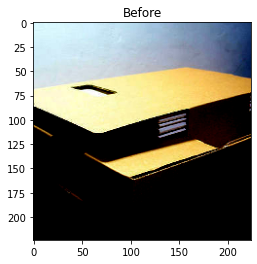

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


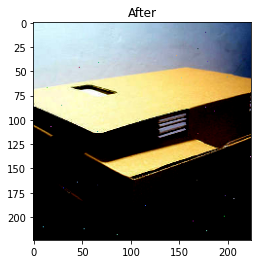


Final probability to be classified correctly: 0.3856431
Final probability to be classified as: 553  is  0.4416056
_________________________


11

___________________
Correct label: 517
Initial class: 517
Initial probability to be classified correctly: 0.9650065


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 7 generations
Label: 517 ; Prediction: 821
Fitness: 0.5835198


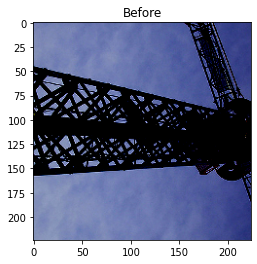

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


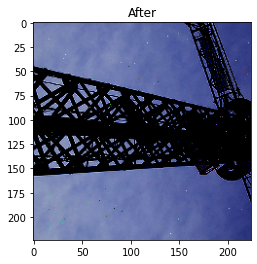


Final probability to be classified correctly: 0.4164802
Final probability to be classified as: 821  is  0.41781452
_________________________


12

___________________
Correct label: 334
Initial class: 334
Initial probability to be classified correctly: 0.9992231


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 32 generations
Label: 334 ; Prediction: 102
Fitness: 0.5173918


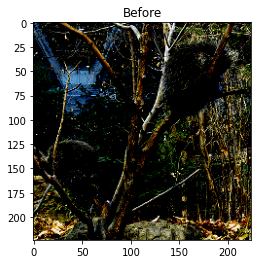

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


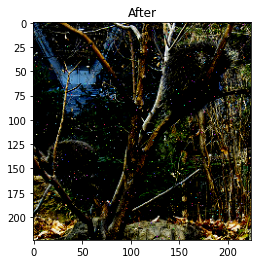


Final probability to be classified correctly: 0.4826082
Final probability to be classified as: 102  is  0.49832022
_________________________


13

___________________
Correct label: 948
Initial class: 948
Initial probability to be classified correctly: 0.9998276
Final probability to be classified correctly: 0.9437163
Final probability to be classified as: 948  is  0.9437163
_________________________


14

___________________
Correct label: 727
Initial class: 727
Initial probability to be classified correctly: 0.9999958
Final probability to be classified correctly: 0.9960305
Final probability to be classified as: 727  is  0.9960305
_________________________


15

___________________
Correct label: 23
Initial class: 23
Initial probability to be classified correctly: 0.95093066


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 22 generations
Label: 23 ; Prediction: 80
Fitness: 0.608166


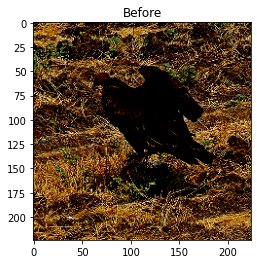

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


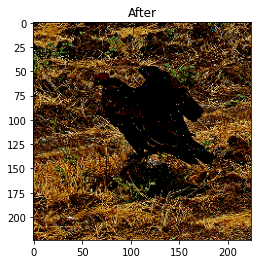


Final probability to be classified correctly: 0.39183402
Final probability to be classified as: 80  is  0.41043025
_________________________


16

___________________
Correct label: 846
Initial class: 846
Initial probability to be classified correctly: 0.49201155


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 1 generations
Label: 846 ; Prediction: 583
Fitness: 0.8434988


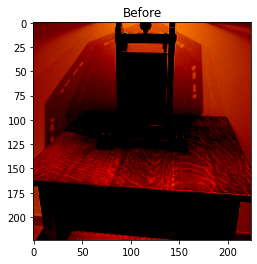

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


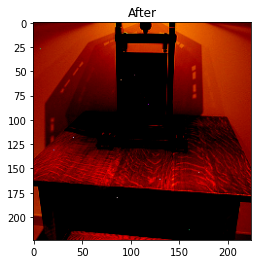


Final probability to be classified correctly: 0.15650114
Final probability to be classified as: 583  is  0.6532203
_________________________


17

___________________
Correct label: 270
Initial class: 270
Initial probability to be classified correctly: 0.9855338


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 39 generations
Label: 270 ; Prediction: 269
Fitness: 0.50549996


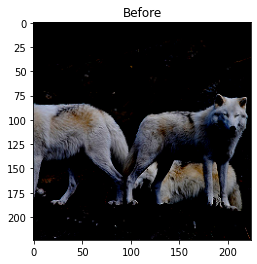

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


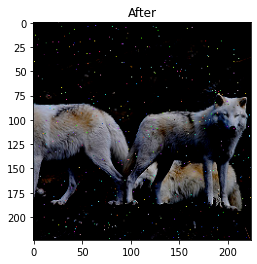


Final probability to be classified correctly: 0.49450007
Final probability to be classified as: 269  is  0.503688
_________________________


18

___________________
Correct label: 55
Initial class: 55
Initial probability to be classified correctly: 0.7788542


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 21 generations
Label: 55 ; Prediction: 64
Fitness: 0.58689785


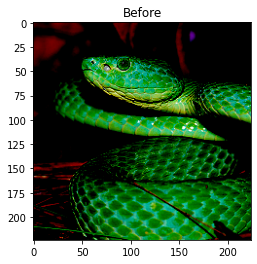

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


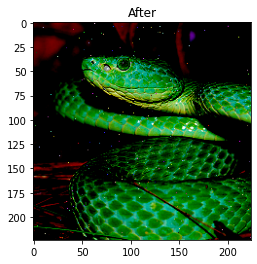


Final probability to be classified correctly: 0.41310215
Final probability to be classified as: 64  is  0.42296475
_________________________


19

___________________
Correct label: 858
Initial class: 858
Initial probability to be classified correctly: 0.8472209


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 858 ; Prediction: 588
Fitness: 0.6584257


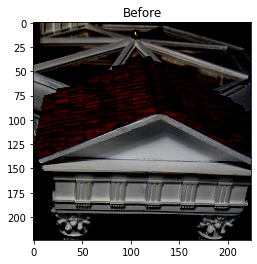

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


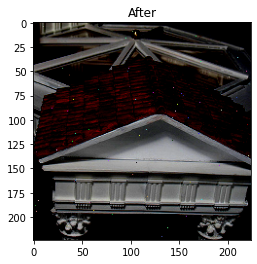


Final probability to be classified correctly: 0.34157428
Final probability to be classified as: 588  is  0.38389882
_________________________


20

___________________
Correct label: 324
Initial class: 324
Initial probability to be classified correctly: 0.97705966


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 29 generations
Label: 324 ; Prediction: 325
Fitness: 0.5043489


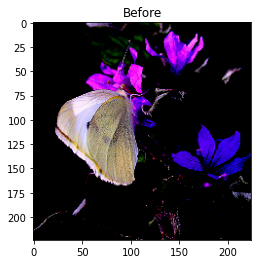

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


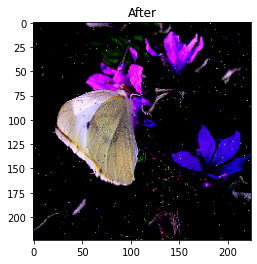


Final probability to be classified correctly: 0.4956511
Final probability to be classified as: 325  is  0.5023486
_________________________


21

___________________
Correct label: 573
Initial class: 573
Initial probability to be classified correctly: 0.47387356


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 573 ; Prediction: 779
Fitness: 0.7695787


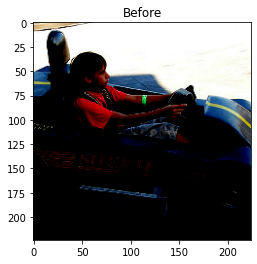

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


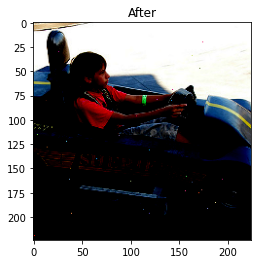


Final probability to be classified correctly: 0.23042129
Final probability to be classified as: 779  is  0.30709377
_________________________


22

___________________
Correct label: 981
Initial class: 981
Initial probability to be classified correctly: 0.47728527


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 981 ; Prediction: 879
Fitness: 0.8582133


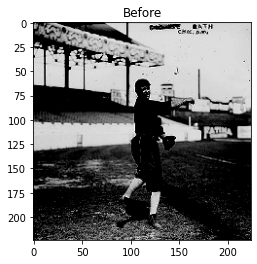

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


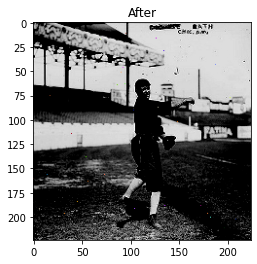


Final probability to be classified correctly: 0.14178666
Final probability to be classified as: 879  is  0.3170888
_________________________


23

___________________
Correct label: 586
Initial class: 586
Initial probability to be classified correctly: 0.9960168


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 23 generations
Label: 586 ; Prediction: 847
Fitness: 0.52059186


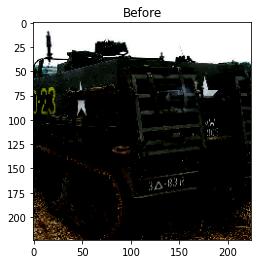

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


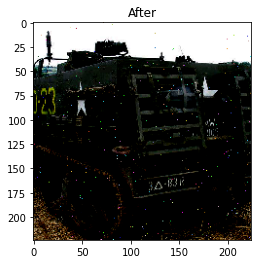


Final probability to be classified correctly: 0.47940814
Final probability to be classified as: 847  is  0.5034947
_________________________


24

___________________
Correct label: 887
Initial class: 887
Initial probability to be classified correctly: 0.99881786
Final probability to be classified correctly: 0.47713405
Final probability to be classified as: 887  is  0.47713405
_________________________


25

___________________
Correct label: 398
Initial class: 398
Initial probability to be classified correctly: 0.5092653


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 398 ; Prediction: 921
Fitness: 0.7111168


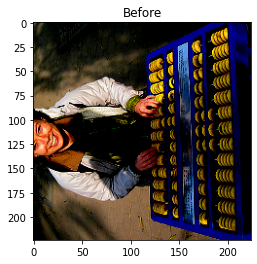

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


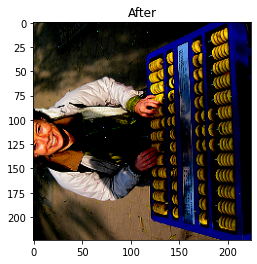


Final probability to be classified correctly: 0.28888324
Final probability to be classified as: 921  is  0.41016445
_________________________


26

___________________
Correct label: 756
Initial class: 756
Initial probability to be classified correctly: 0.93339735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 7 generations
Label: 756 ; Prediction: 448
Fitness: 0.7778784


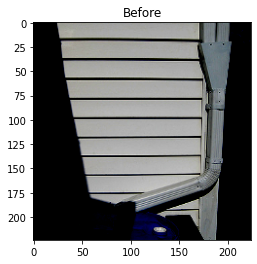

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


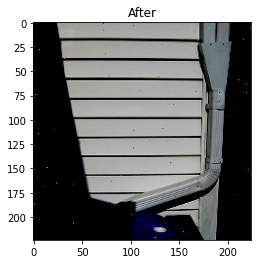


Final probability to be classified correctly: 0.22212157
Final probability to be classified as: 448  is  0.33383375
_________________________


27

___________________
Correct label: 129
Initial class: 129
Initial probability to be classified correctly: 0.9925303


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 24 generations
Label: 129 ; Prediction: 134
Fitness: 0.56253636


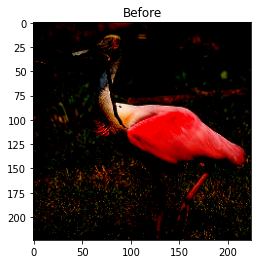

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


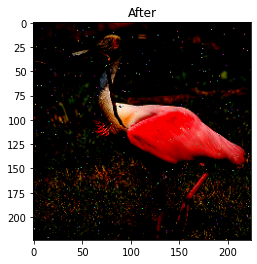


Final probability to be classified correctly: 0.43746367
Final probability to be classified as: 134  is  0.49251083
_________________________


28

___________________
Correct label: 198
Initial class: 198
Initial probability to be classified correctly: 0.96996135


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 16 generations
Label: 198 ; Prediction: 196
Fitness: 0.52362764


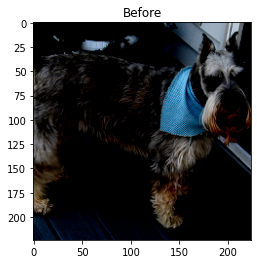

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


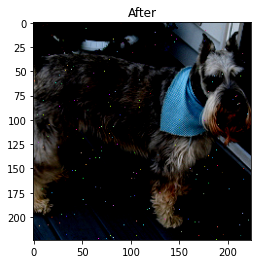


Final probability to be classified correctly: 0.47637233
Final probability to be classified as: 196  is  0.49937582
_________________________


29

___________________
Correct label: 256
Initial class: 256
Initial probability to be classified correctly: 0.9990426


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 19 generations
Label: 256 ; Prediction: 197
Fitness: 0.66071105


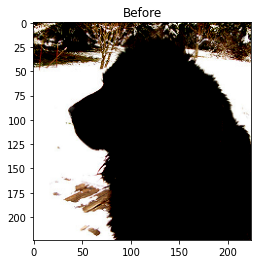

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


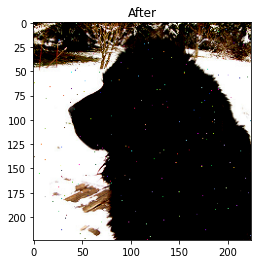


Final probability to be classified correctly: 0.33928895
Final probability to be classified as: 197  is  0.34611875
_________________________


30

___________________
Correct label: 725
Initial class: 725
Initial probability to be classified correctly: 0.5410388


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 725 ; Prediction: 606
Fitness: 0.71545947


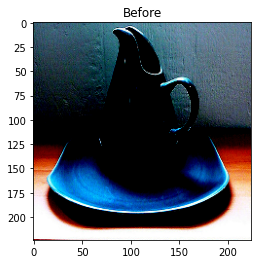

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


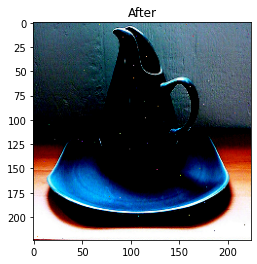


Final probability to be classified correctly: 0.28454053
Final probability to be classified as: 606  is  0.37077224
_________________________


31

___________________
Correct label: 565
Initial class: 565
Initial probability to be classified correctly: 0.89801973


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 8 generations
Label: 565 ; Prediction: 477
Fitness: 0.5829958


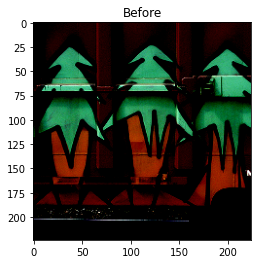

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


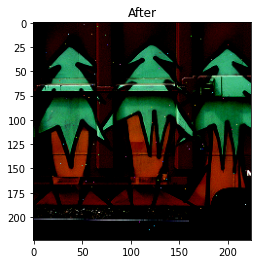


Final probability to be classified correctly: 0.41700423
Final probability to be classified as: 477  is  0.55882436
_________________________


32

___________________
Correct label: 717
Initial class: 717
Initial probability to be classified correctly: 0.98130786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 11 generations
Label: 717 ; Prediction: 468
Fitness: 0.66429937


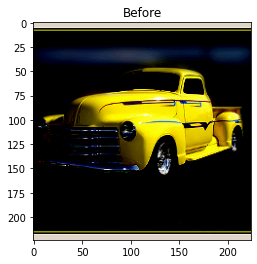

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


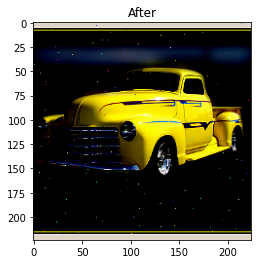


Final probability to be classified correctly: 0.3357006
Final probability to be classified as: 468  is  0.33750403
_________________________


33

___________________
Correct label: 92
Initial class: 92
Initial probability to be classified correctly: 0.68445385


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 92 ; Prediction: 15
Fitness: 0.69016004


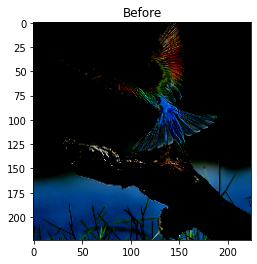

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


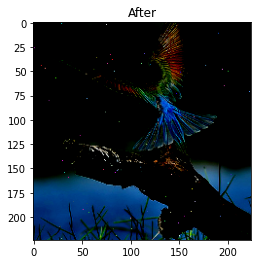


Final probability to be classified correctly: 0.30984
Final probability to be classified as: 15  is  0.40510306
_________________________


34

___________________
Correct label: 29
Initial class: 29
Initial probability to be classified correctly: 0.99999905
Final probability to be classified correctly: 0.9248413
Final probability to be classified as: 29  is  0.9248413
_________________________


35

___________________
Correct label: 844
Initial class: 844
Initial probability to be classified correctly: 0.99997663


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 38 generations
Label: 844 ; Prediction: 813
Fitness: 0.5776651


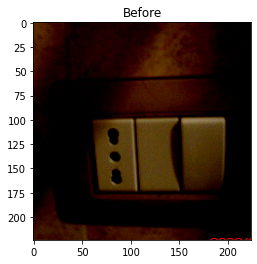

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


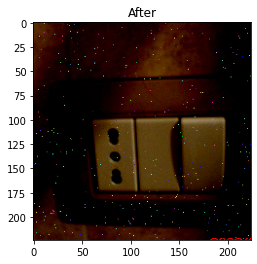


Final probability to be classified correctly: 0.4223349
Final probability to be classified as: 813  is  0.4858506
_________________________


36

___________________
Correct label: 591
Initial class: 591
Initial probability to be classified correctly: 0.9999689


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 19 generations
Label: 591 ; Prediction: 868
Fitness: 0.54601574


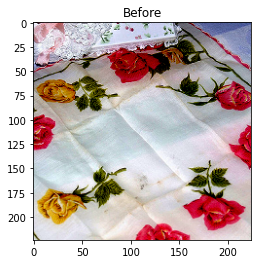

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


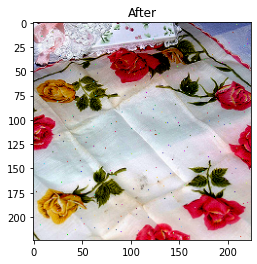


Final probability to be classified correctly: 0.45398426
Final probability to be classified as: 868  is  0.50158215
_________________________


37

___________________
Correct label: 468
Initial class: 468
Initial probability to be classified correctly: 0.72695804


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 468 ; Prediction: 436
Fitness: 0.77276665


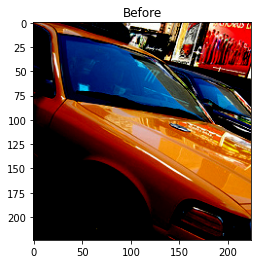

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


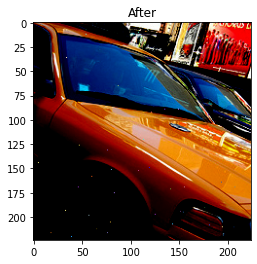


Final probability to be classified correctly: 0.22723334
Final probability to be classified as: 436  is  0.30285138
_________________________


38

___________________
Correct label: 994
Initial class: 994
Initial probability to be classified correctly: 0.9993337
Final probability to be classified correctly: 0.5227431
Final probability to be classified as: 994  is  0.5227431
_________________________


39

___________________
Correct label: 588
Initial class: 588
Initial probability to be classified correctly: 0.98997587


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 11 generations
Label: 588 ; Prediction: 482
Fitness: 0.72767425


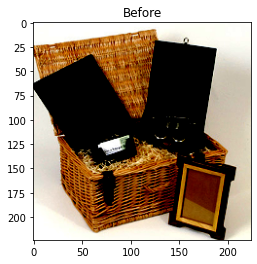

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


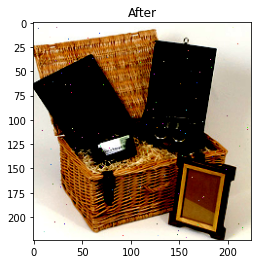


Final probability to be classified correctly: 0.27232578
Final probability to be classified as: 482  is  0.3301065
_________________________


40

___________________
Correct label: 474
Initial class: 474
Initial probability to be classified correctly: 0.8436785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 474 ; Prediction: 735
Fitness: 0.51673144


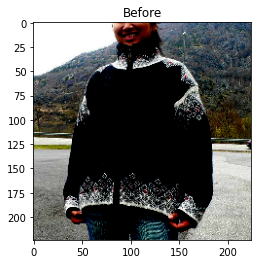

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


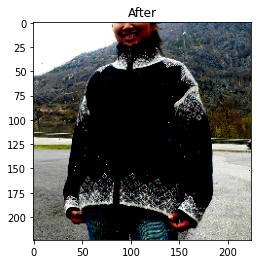


Final probability to be classified correctly: 0.48326856
Final probability to be classified as: 735  is  0.5054353
_________________________


41

___________________
Correct label: 107
Initial class: 107
Initial probability to be classified correctly: 0.9700134


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 107 ; Prediction: 5
Fitness: 0.7676232


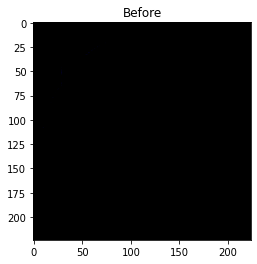

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


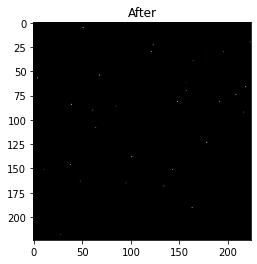


Final probability to be classified correctly: 0.2323768
Final probability to be classified as: 5  is  0.3122555
_________________________


42

___________________
Correct label: 46
Initial class: 46
Initial probability to be classified correctly: 0.65781516


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 46 ; Prediction: 29
Fitness: 0.62908447


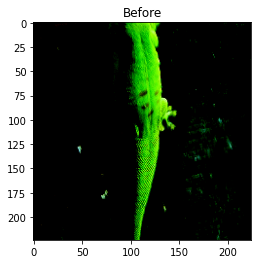

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


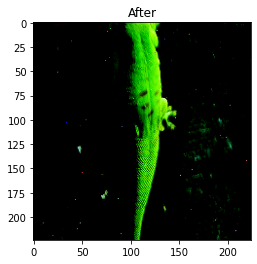


Final probability to be classified correctly: 0.37091556
Final probability to be classified as: 29  is  0.3739017
_________________________


43

___________________
Correct label: 390
Initial class: 390
Initial probability to be classified correctly: 0.9964874


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 24 generations
Label: 390 ; Prediction: 360
Fitness: 0.7456523


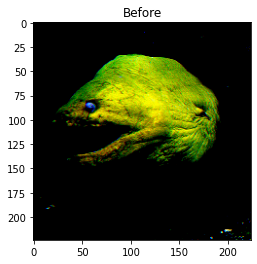

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


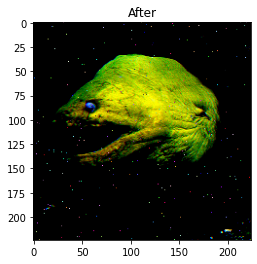


Final probability to be classified correctly: 0.2543477
Final probability to be classified as: 360  is  0.33433723
_________________________


44

___________________
Correct label: 101
Initial class: 101
Initial probability to be classified correctly: 0.9750133


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 27 generations
Label: 101 ; Prediction: 386
Fitness: 0.503137


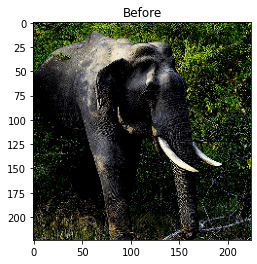

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


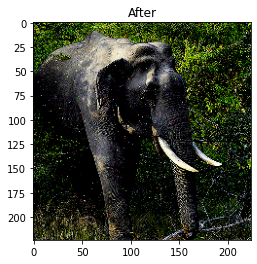


Final probability to be classified correctly: 0.496863
Final probability to be classified as: 386  is  0.4992579
_________________________


45

___________________
Correct label: 887
Initial class: 887
Initial probability to be classified correctly: 0.68295693


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 10 generations
Label: 887 ; Prediction: 591
Fitness: 0.68160254


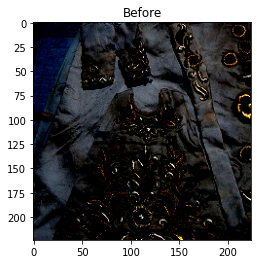

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


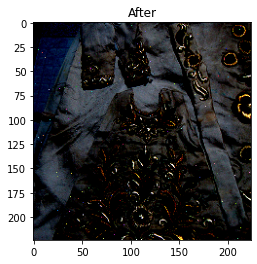


Final probability to be classified correctly: 0.31839746
Final probability to be classified as: 591  is  0.33051974
_________________________


46

___________________
Correct label: 870
Initial class: 870
Initial probability to be classified correctly: 0.77169657


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 12 generations
Label: 870 ; Prediction: 463
Fitness: 0.80272925


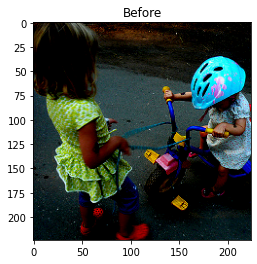

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


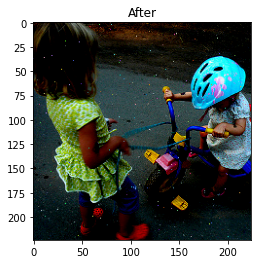


Final probability to be classified correctly: 0.19727078
Final probability to be classified as: 463  is  0.2549966
_________________________


47

___________________
Correct label: 149
Initial class: 149
Initial probability to be classified correctly: 0.9420275


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 31 generations
Label: 149 ; Prediction: 3
Fitness: 0.63195634


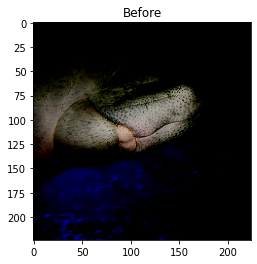

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


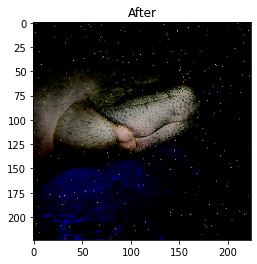


Final probability to be classified correctly: 0.36804366
Final probability to be classified as: 3  is  0.4224514
_________________________


48

___________________
Correct label: 21
Initial class: 21
Initial probability to be classified correctly: 0.5798306


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 3 generations
Label: 21 ; Prediction: 157
Fitness: 0.9110826


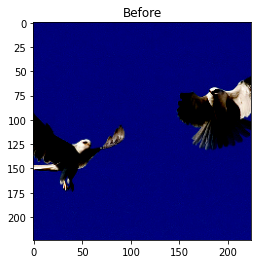

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


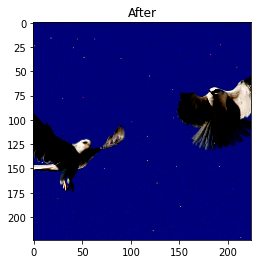


Final probability to be classified correctly: 0.088917404
Final probability to be classified as: 157  is  0.1673077
_________________________


49

___________________
Correct label: 476
Initial class: 476
Initial probability to be classified correctly: 0.9135339


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 18 generations
Label: 476 ; Prediction: 865
Fitness: 0.70157933


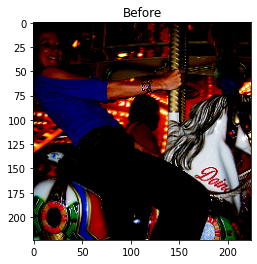

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


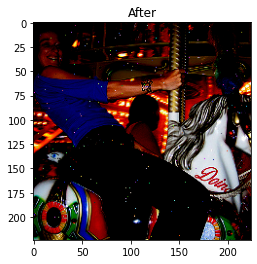


Final probability to be classified correctly: 0.29842067
Final probability to be classified as: 865  is  0.31624106
_________________________


50

___________________
Correct label: 80
Initial class: 80
Initial probability to be classified correctly: 0.99979454
Final probability to be classified correctly: 0.8466943
Final probability to be classified as: 80  is  0.8466943
_________________________


51

___________________
Correct label: 424
Initial class: 424
Initial probability to be classified correctly: 0.6554972


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 424 ; Prediction: 415
Fitness: 0.6180694


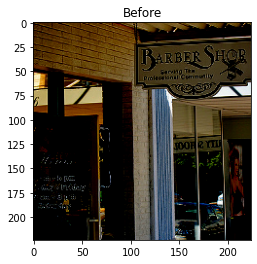

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


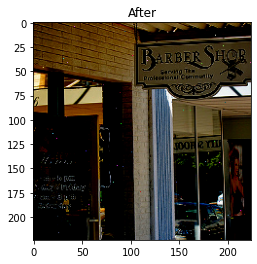


Final probability to be classified correctly: 0.38193062
Final probability to be classified as: 415  is  0.39630735
_________________________


52

___________________
Correct label: 159
Initial class: 159
Initial probability to be classified correctly: 0.68074673


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 9 generations
Label: 159 ; Prediction: 246
Fitness: 0.6214982


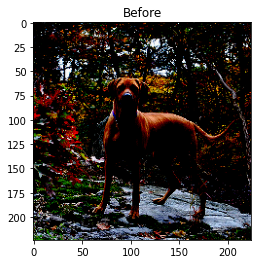

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


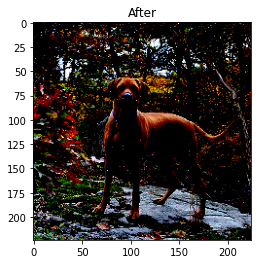


Final probability to be classified correctly: 0.37850177
Final probability to be classified as: 246  is  0.42441446
_________________________


53

___________________
Correct label: 275
Initial class: 275
Initial probability to be classified correctly: 0.99973816


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 24 generations
Label: 275 ; Prediction: 179
Fitness: 0.5331063


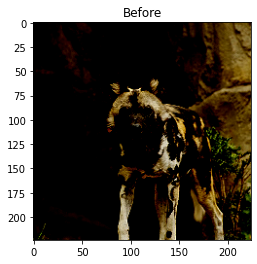

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


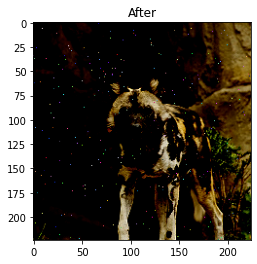


Final probability to be classified correctly: 0.46689367
Final probability to be classified as: 179  is  0.48072502
_________________________


54

___________________
Correct label: 175
Initial class: 175
Initial probability to be classified correctly: 0.5505416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 175 ; Prediction: 192
Fitness: 0.7006454


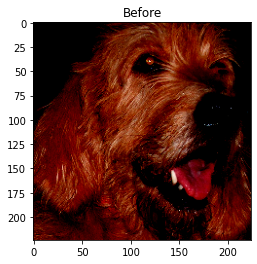

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


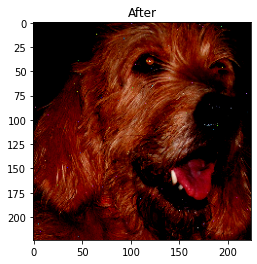


Final probability to be classified correctly: 0.2993546
Final probability to be classified as: 192  is  0.31534463
_________________________


55

___________________
Correct label: 461
Initial class: 461
Initial probability to be classified correctly: 0.977772
Final probability to be classified correctly: 0.63778526
Final probability to be classified as: 461  is  0.63778526
_________________________


56

___________________
Correct label: 970
Initial class: 970
Initial probability to be classified correctly: 0.9877108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 29 generations
Label: 970 ; Prediction: 672
Fitness: 0.5109278


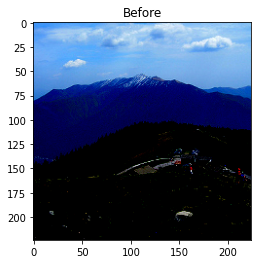

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


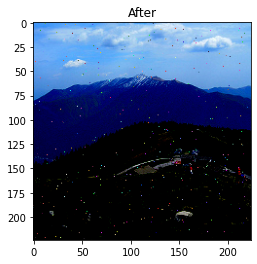


Final probability to be classified correctly: 0.4890722
Final probability to be classified as: 672  is  0.49854517
_________________________


57

___________________
Correct label: 160
Initial class: 160
Initial probability to be classified correctly: 0.99996173


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 41 generations
Label: 160 ; Prediction: 226
Fitness: 0.55321634


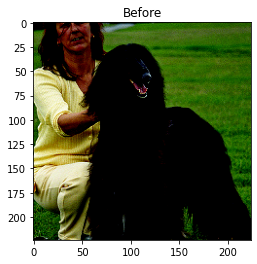

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


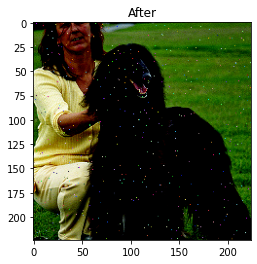


Final probability to be classified correctly: 0.44678363
Final probability to be classified as: 226  is  0.4612352
_________________________


58

___________________
Correct label: 788
Initial class: 788
Initial probability to be classified correctly: 0.89557195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 788 ; Prediction: 422
Fitness: 0.5717089


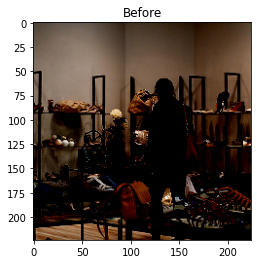

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


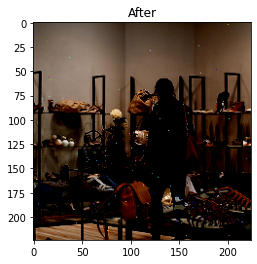


Final probability to be classified correctly: 0.42829105
Final probability to be classified as: 422  is  0.47664863
_________________________


59

___________________
Correct label: 498
Initial class: 498
Initial probability to be classified correctly: 0.997215


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 30 generations
Label: 498 ; Prediction: 698
Fitness: 0.53500557


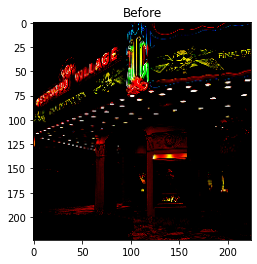

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


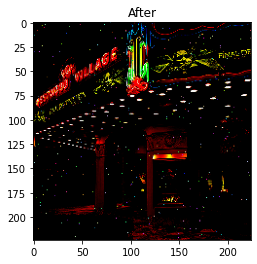


Final probability to be classified correctly: 0.46499443
Final probability to be classified as: 698  is  0.46630403
_________________________


60

___________________
Correct label: 369
Initial class: 369
Initial probability to be classified correctly: 0.33897948


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 1 generations
Label: 369 ; Prediction: 384
Fitness: 0.89212644


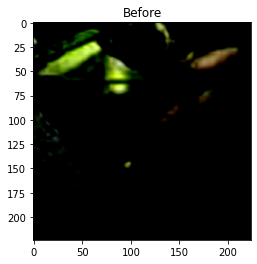

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


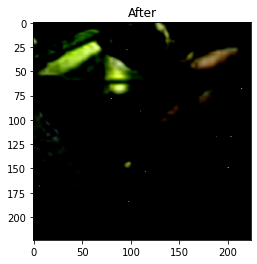


Final probability to be classified correctly: 0.10787356
Final probability to be classified as: 384  is  0.55287516
_________________________


61

___________________
Correct label: 28
Initial class: 28
Initial probability to be classified correctly: 0.63906723


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 28 ; Prediction: 25
Fitness: 0.5579088


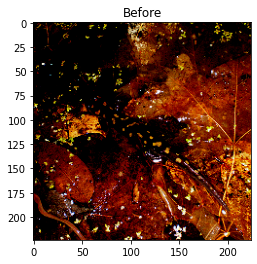

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


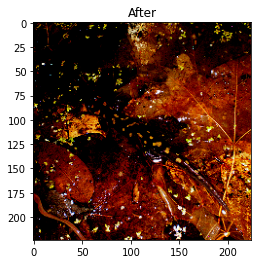


Final probability to be classified correctly: 0.44209126
Final probability to be classified as: 25  is  0.5317384
_________________________


62

___________________
Correct label: 487
Initial class: 487
Initial probability to be classified correctly: 0.9996599


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 36 generations
Label: 487 ; Prediction: 761
Fitness: 0.50714684


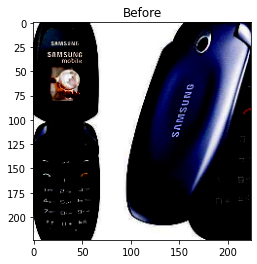

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


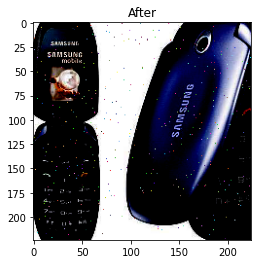


Final probability to be classified correctly: 0.49285313
Final probability to be classified as: 761  is  0.50253546
_________________________


63

___________________
Correct label: 50
Initial class: 50
Initial probability to be classified correctly: 0.93277615


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 21 generations
Label: 50 ; Prediction: 49
Fitness: 0.51441765


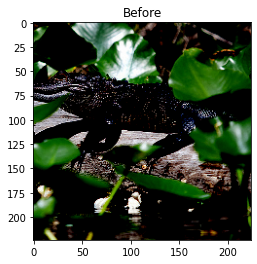

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


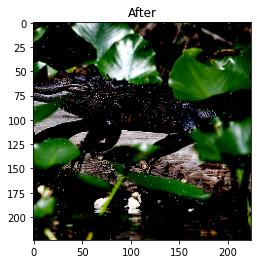


Final probability to be classified correctly: 0.48558235
Final probability to be classified as: 49  is  0.4906526
_________________________


64

___________________
Correct label: 270
Initial class: 270
Initial probability to be classified correctly: 0.9969041


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 32 generations
Label: 270 ; Prediction: 258
Fitness: 0.5677875


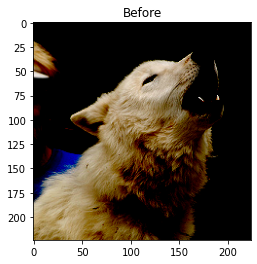

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


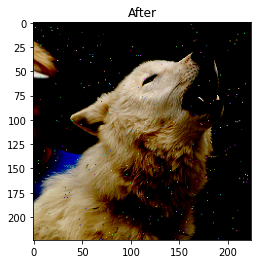


Final probability to be classified correctly: 0.43221244
Final probability to be classified as: 258  is  0.48461947
_________________________


65

___________________
Correct label: 366
Initial class: 366
Initial probability to be classified correctly: 0.88991416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 9 generations
Label: 366 ; Prediction: 347
Fitness: 0.81371206


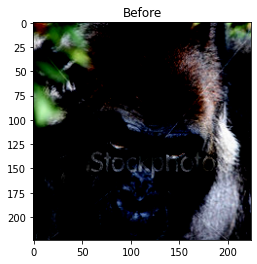

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


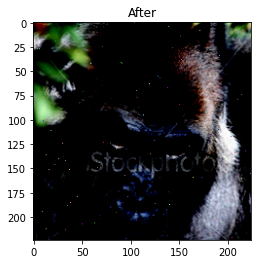


Final probability to be classified correctly: 0.18628794
Final probability to be classified as: 347  is  0.23594075
_________________________


66

___________________
Correct label: 373
Initial class: 373
Initial probability to be classified correctly: 0.92362005
Final probability to be classified correctly: 0.31628606
Final probability to be classified as: 373  is  0.31628606
_________________________


67

___________________
Correct label: 705
Initial class: 705
Initial probability to be classified correctly: 0.8867131


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 16 generations
Label: 705 ; Prediction: 547
Fitness: 0.54407114


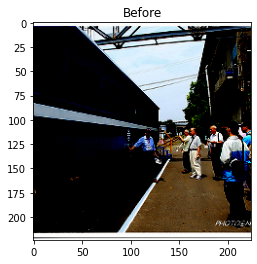

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


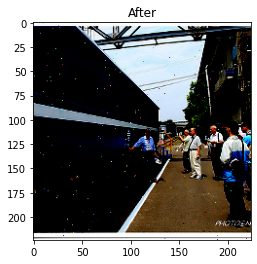


Final probability to be classified correctly: 0.45592886
Final probability to be classified as: 547  is  0.47454882
_________________________


68

___________________
Correct label: 330
Initial class: 330
Initial probability to be classified correctly: 0.92042077


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 330 ; Prediction: 331
Fitness: 0.56772405


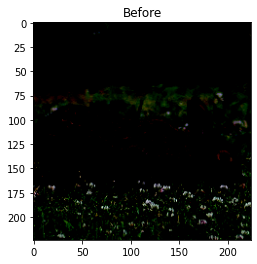

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


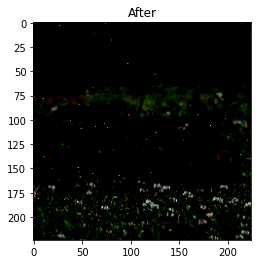


Final probability to be classified correctly: 0.43227595
Final probability to be classified as: 331  is  0.5677166
_________________________


69

___________________
Correct label: 142
Initial class: 142
Initial probability to be classified correctly: 0.89253294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 16 generations
Label: 142 ; Prediction: 141
Fitness: 0.57782674


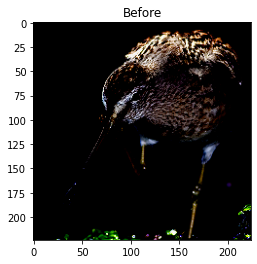

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


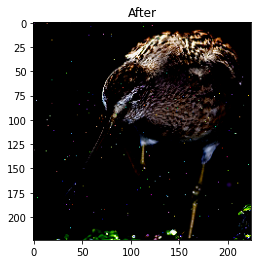


Final probability to be classified correctly: 0.42217323
Final probability to be classified as: 141  is  0.4447537
_________________________


70

___________________
Correct label: 949
Initial class: 949
Initial probability to be classified correctly: 0.9994604
Final probability to be classified correctly: 0.5621386
Final probability to be classified as: 949  is  0.5621386
_________________________


71

___________________
Correct label: 349
Initial class: 349
Initial probability to be classified correctly: 0.80765086


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 13 generations
Label: 349 ; Prediction: 350
Fitness: 0.5190027


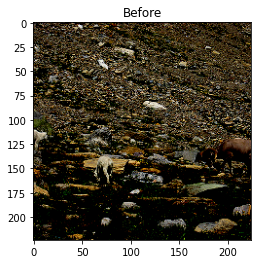

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


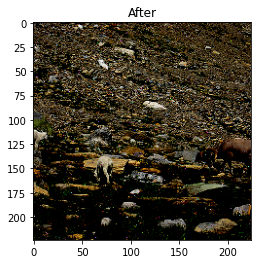


Final probability to be classified correctly: 0.48099732
Final probability to be classified as: 350  is  0.4836588
_________________________


72

___________________
Correct label: 473
Initial class: 473
Initial probability to be classified correctly: 0.7889742


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 473 ; Prediction: 861
Fitness: 0.78078985


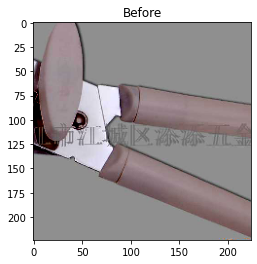

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


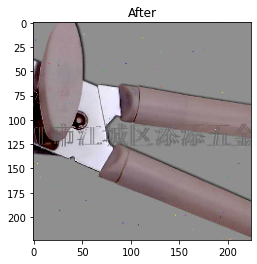


Final probability to be classified correctly: 0.21921013
Final probability to be classified as: 861  is  0.26069564
_________________________


73

___________________
Correct label: 159
Initial class: 159
Initial probability to be classified correctly: 0.69570154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 159 ; Prediction: 246
Fitness: 0.5772431


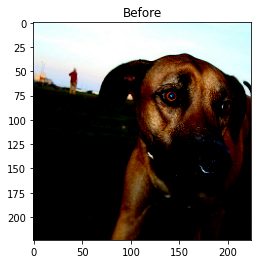

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


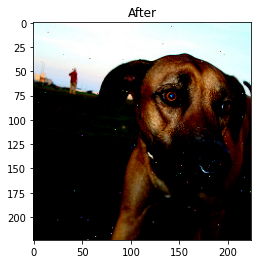


Final probability to be classified correctly: 0.42275694
Final probability to be classified as: 246  is  0.43571854
_________________________


74

___________________
Correct label: 872
Initial class: 872
Initial probability to be classified correctly: 0.95259535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 8 generations
Label: 872 ; Prediction: 447
Fitness: 0.8515005


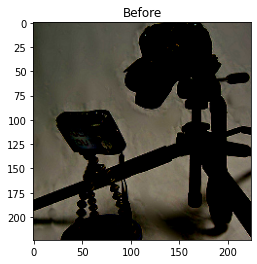

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


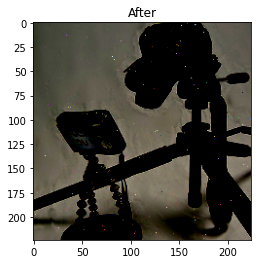


Final probability to be classified correctly: 0.14849952
Final probability to be classified as: 447  is  0.14979787
_________________________


75

___________________
Correct label: 201
Initial class: 201
Initial probability to be classified correctly: 0.8140095


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 16 generations
Label: 201 ; Prediction: 187
Fitness: 0.56426454


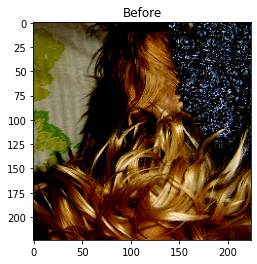

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


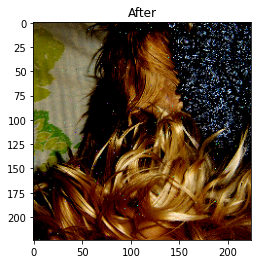


Final probability to be classified correctly: 0.4357355
Final probability to be classified as: 187  is  0.464386
_________________________


76

___________________
Correct label: 906
Initial class: 906
Initial probability to be classified correctly: 0.8479754


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 6 generations
Label: 906 ; Prediction: 883
Fitness: 0.8460443


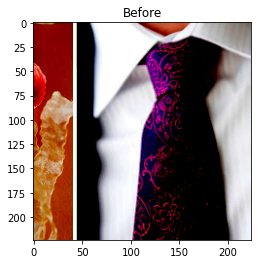

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


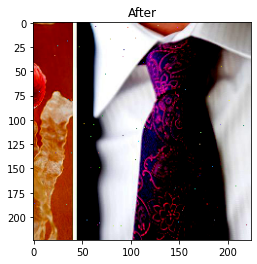


Final probability to be classified correctly: 0.15395573
Final probability to be classified as: 883  is  0.2256174
_________________________


77

___________________
Correct label: 70
Initial class: 70
Initial probability to be classified correctly: 0.99642664


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 26 generations
Label: 70 ; Prediction: 75
Fitness: 0.54034996


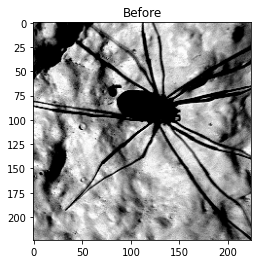

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


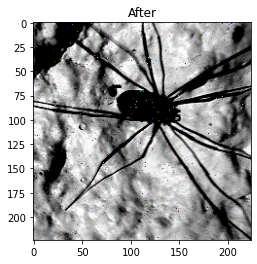


Final probability to be classified correctly: 0.45965007
Final probability to be classified as: 75  is  0.5313669
_________________________


78

___________________
Correct label: 486
Initial class: 486
Initial probability to be classified correctly: 0.51427436


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 1 generations
Label: 486 ; Prediction: 889
Fitness: 0.53906775


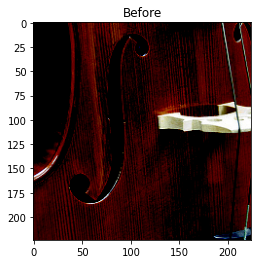

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


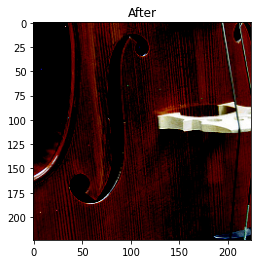


Final probability to be classified correctly: 0.46093228
Final probability to be classified as: 889  is  0.5381655
_________________________


79

___________________
Correct label: 632
Initial class: 632
Initial probability to be classified correctly: 0.7855814


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 632 ; Prediction: 485
Fitness: 0.5799038


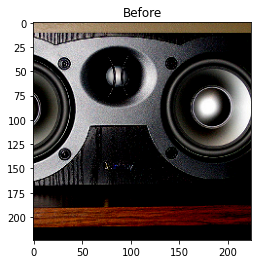

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


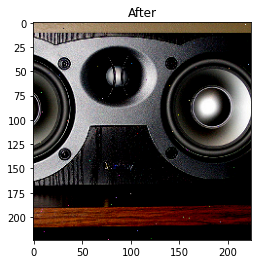


Final probability to be classified correctly: 0.42009622
Final probability to be classified as: 485  is  0.4356087
_________________________


80

___________________
Correct label: 122
Initial class: 122
Initial probability to be classified correctly: 0.9475455


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 19 generations
Label: 122 ; Prediction: 934
Fitness: 0.60917634


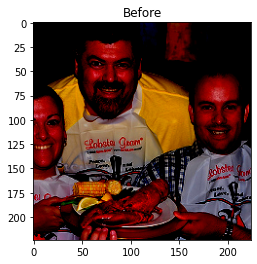

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


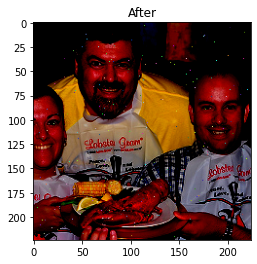


Final probability to be classified correctly: 0.39082366
Final probability to be classified as: 934  is  0.4651369
_________________________


81

___________________
Correct label: 227
Initial class: 227
Initial probability to be classified correctly: 0.9764813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 14 generations
Label: 227 ; Prediction: 236
Fitness: 0.742131


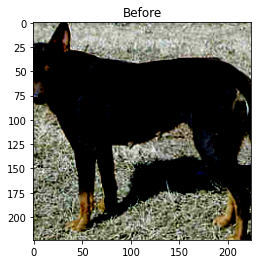

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


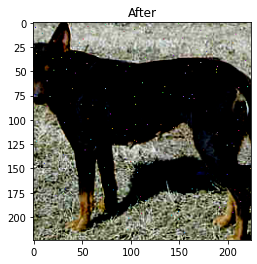


Final probability to be classified correctly: 0.25786904
Final probability to be classified as: 236  is  0.37303013
_________________________


82

___________________
Correct label: 173
Initial class: 173
Initial probability to be classified correctly: 0.7464207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 10 generations
Label: 173 ; Prediction: 253
Fitness: 0.5891782


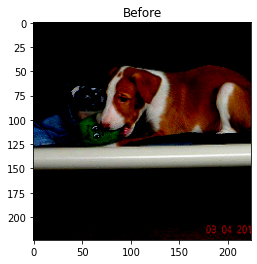

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


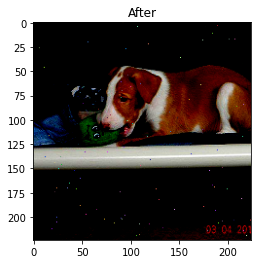


Final probability to be classified correctly: 0.41082183
Final probability to be classified as: 253  is  0.4565151
_________________________


83

___________________
Correct label: 959
Initial class: 959
Initial probability to be classified correctly: 0.99674606


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 47 generations
Label: 959 ; Prediction: 940
Fitness: 0.5302222


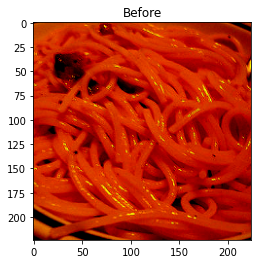

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


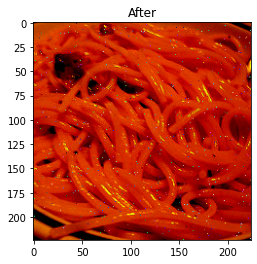


Final probability to be classified correctly: 0.4697778
Final probability to be classified as: 940  is  0.5098126
_________________________


84

___________________
Correct label: 638
Initial class: 638
Initial probability to be classified correctly: 0.70002156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 5 generations
Label: 638 ; Prediction: 445
Fitness: 0.6105306


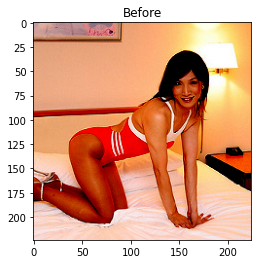

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


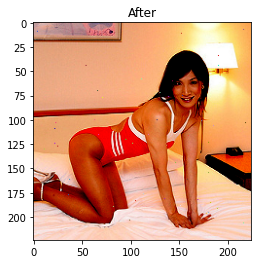


Final probability to be classified correctly: 0.38946936
Final probability to be classified as: 445  is  0.47793254
_________________________


85

___________________
Correct label: 645
Initial class: 645
Initial probability to be classified correctly: 0.99724764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 50 generations
Label: 645 ; Prediction: 456
Fitness: 0.51667684


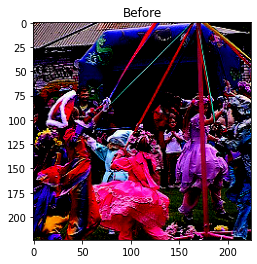

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


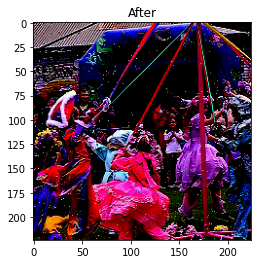


Final probability to be classified correctly: 0.48332316
Final probability to be classified as: 456  is  0.4888735
_________________________


86

___________________
Correct label: 483
Initial class: 483
Initial probability to be classified correctly: 0.85721725


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 12 generations
Label: 483 ; Prediction: 913
Fitness: 0.84976554


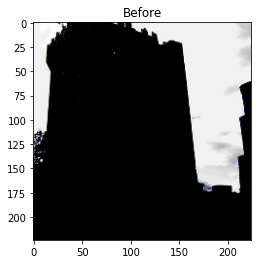

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


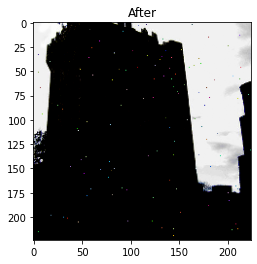


Final probability to be classified correctly: 0.15023443
Final probability to be classified as: 913  is  0.19141424
_________________________


87

___________________
Correct label: 852
Initial class: 852
Initial probability to be classified correctly: 0.9999486


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 13 generations
Label: 852 ; Prediction: 714
Fitness: 0.5699087


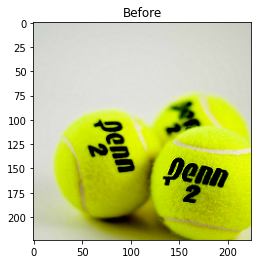

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


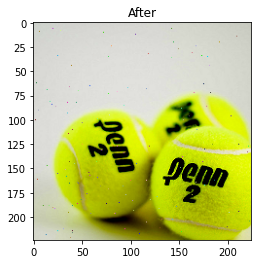


Final probability to be classified correctly: 0.43009132
Final probability to be classified as: 714  is  0.52224916
_________________________


88

___________________
Correct label: 457
Initial class: 457
Initial probability to be classified correctly: 0.98368376


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 12 generations
Label: 457 ; Prediction: 869
Fitness: 0.6288665


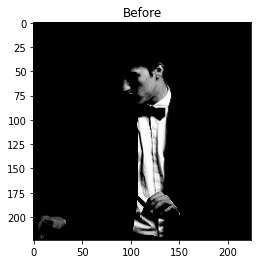

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


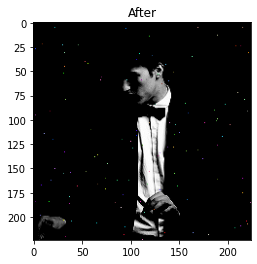


Final probability to be classified correctly: 0.3711335
Final probability to be classified as: 869  is  0.42538095
_________________________


89

___________________
Correct label: 352
Initial class: 352
Initial probability to be classified correctly: 0.981914


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 32 generations
Label: 352 ; Prediction: 353
Fitness: 0.5396044


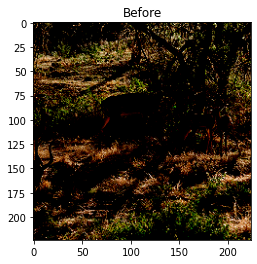

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


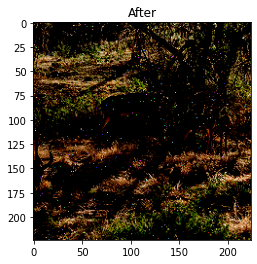


Final probability to be classified correctly: 0.46039554
Final probability to be classified as: 353  is  0.4934361
_________________________


90

___________________
Correct label: 934
Initial class: 934
Initial probability to be classified correctly: 0.64082783


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 4 generations
Label: 934 ; Prediction: 924
Fitness: 0.69683635


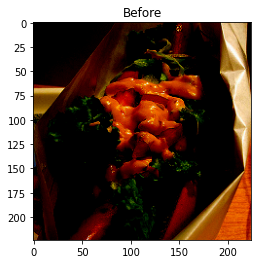

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


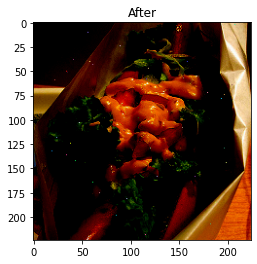


Final probability to be classified correctly: 0.30316368
Final probability to be classified as: 924  is  0.33422127
_________________________


91

___________________
Correct label: 283
Initial class: 283
Initial probability to be classified correctly: 0.99419445


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 31 generations
Label: 283 ; Prediction: 260
Fitness: 0.6357334


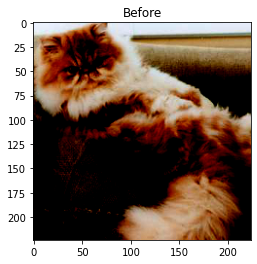

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


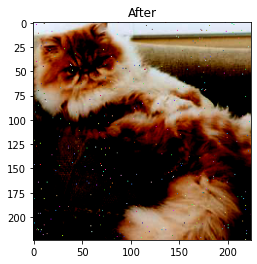


Final probability to be classified correctly: 0.36426657
Final probability to be classified as: 260  is  0.37808007
_________________________


92

___________________
Correct label: 802
Initial class: 802
Initial probability to be classified correctly: 0.9983972
Final probability to be classified correctly: 0.578146
Final probability to be classified as: 802  is  0.578146
_________________________


93

___________________
Correct label: 553
Initial class: 553
Initial probability to be classified correctly: 0.88553685


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 9 generations
Label: 553 ; Prediction: 859
Fitness: 0.73682153


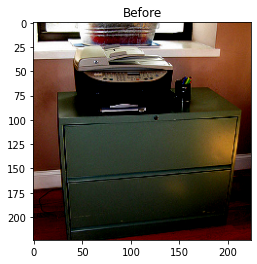

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


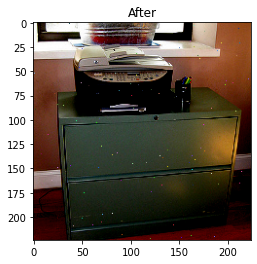


Final probability to be classified correctly: 0.26317847
Final probability to be classified as: 859  is  0.30219293
_________________________


94

___________________
Correct label: 276
Initial class: 276
Initial probability to be classified correctly: 0.9990158
Final probability to be classified correctly: 0.8893085
Final probability to be classified as: 276  is  0.8893085
_________________________


95

___________________
Correct label: 751
Initial class: 751
Initial probability to be classified correctly: 0.9633297


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 8 generations
Label: 751 ; Prediction: 829
Fitness: 0.89110297


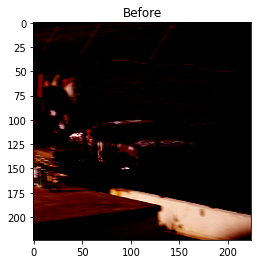

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


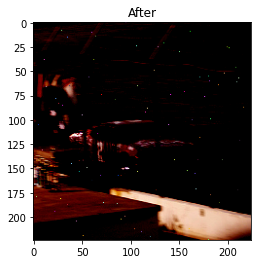


Final probability to be classified correctly: 0.10889704
Final probability to be classified as: 829  is  0.11317061
_________________________


96

___________________
Correct label: 328
Initial class: 328
Initial probability to be classified correctly: 0.99759954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 43 generations
Label: 328 ; Prediction: 644
Fitness: 0.5104426


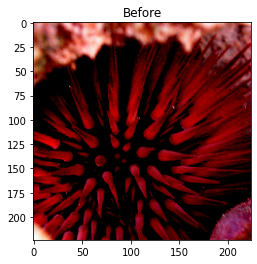

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


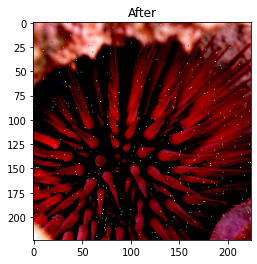


Final probability to be classified correctly: 0.48955742
Final probability to be classified as: 644  is  0.4919199
_________________________


97

___________________
Correct label: 969
Initial class: 969
Initial probability to be classified correctly: 0.80415016


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 2 generations
Label: 969 ; Prediction: 967
Fitness: 0.5754274


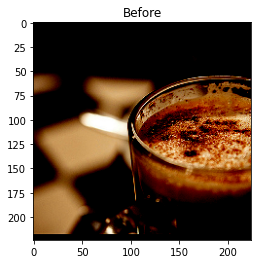

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


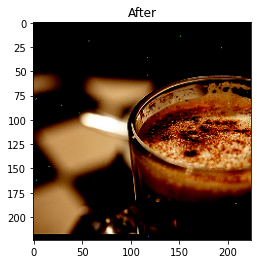


Final probability to be classified correctly: 0.42457256
Final probability to be classified as: 967  is  0.56855166
_________________________


98

___________________
Correct label: 163
Initial class: 163
Initial probability to be classified correctly: 0.9735841


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 8 generations
Label: 163 ; Prediction: 787
Fitness: 0.80070746


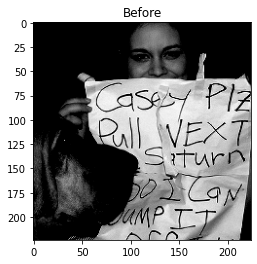

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


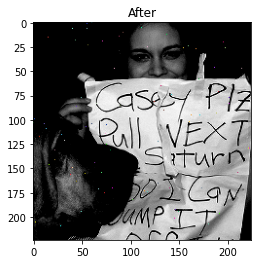


Final probability to be classified correctly: 0.19929254
Final probability to be classified as: 787  is  0.25755444
_________________________


99

___________________
Correct label: 328
Initial class: 328
Initial probability to be classified correctly: 0.9882437


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 38 generations
Label: 328 ; Prediction: 973
Fitness: 0.6068026


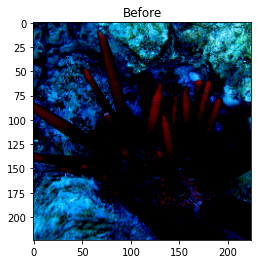

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


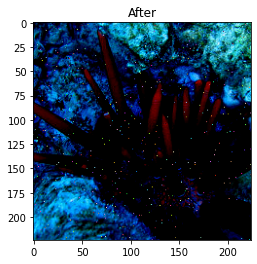


Final probability to be classified correctly: 0.3931974
Final probability to be classified as: 973  is  0.39362586
_________________________



In [168]:
importlib.reload(EvoStrategy)
# TODO: add per channel perturbation, verify that it succeeds faster
# TODO: momentum approach
perturbed_images = 0
adv_evo_strategy = {}
for index in range(100):
    print()
    print(index)
    img = x_val_sample[index]
    label = np.argmax(y_val_one_hot_sample[index])
    adv_evo_strategy[index] = EvoStrategy.AdversarialPerturbationEvoStraegy(
        model=model,
        img=img,
        label=label,
        generation_size=20, 
        one_step_perturbation_pixel_count=10
    )
    no_steps = adv_evo_strategy[index].run_adversarial_attack(steps=50)
    if adv_evo_strategy[index].stop_criterion() and no_steps > 0:
        perturbed_images += 1

In [169]:
count_q = 0
sum_q = 0
for index in range(0,100):
    if(adv_evo_strategy[index].queries > 1):
        count_q +=1
        sum_q += adv_evo_strategy[index].queries
        
print("Average queries for EVO algo:", sum_q/count_q)
print("Total count of perturbed images (classified correctly initially):", perturbed_images)

Average queries for EVO algo: 422.2
Total count of perturbed images (classified correctly initially): 86



0

___________________
Correct label: 65
Initial class: 65
Initial probability to be classified correctly: 0.81139535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 14 generations
Label: 65 ; Prediction: 62
Fitness: 0.7303785


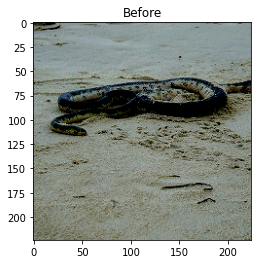

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


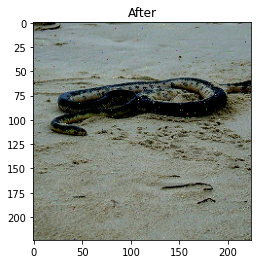


Final probability to be classified correctly: 0.26962152
Final probability to be classified as: 62  is  0.27146888
_________________________


1

___________________
Correct label: 809
Initial class: 809
Initial probability to be classified correctly: 0.6323444


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 2 generations
Label: 809 ; Prediction: 968
Fitness: 0.53136855


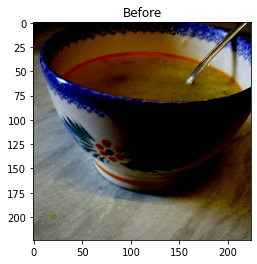

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


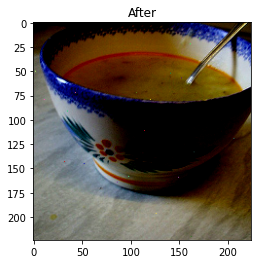


Final probability to be classified correctly: 0.46863145
Final probability to be classified as: 968  is  0.4698406
_________________________


2

___________________
Correct label: 334
Initial class: 334
Initial probability to be classified correctly: 0.9900097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


After 22 generations
Label: 334 ; Prediction: 102
Fitness: 0.67082727


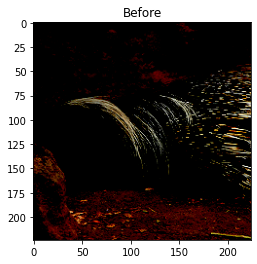

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


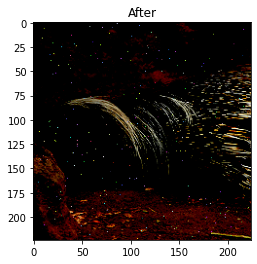


Final probability to be classified correctly: 0.3291727
Final probability to be classified as: 102  is  0.41714597
_________________________


3

___________________
Correct label: 674
Initial class: 674
Initial probability to be classified correctly: 0.99953544


KeyboardInterrupt: 

In [187]:
importlib.reload(EvoStrategy)
import gc
# TODO: add per channel perturbation, verify that it succeeds faster
# TODO: momentum approach
perturbed_images = 0
adv_evo_strategy = {}
for index in range(100):
    print()
    print(index)
    img = x_val_sample[index]
    label = np.argmax(y_val_one_hot_sample[index])
    adv_evo_strategy[index] = EvoStrategy.AdversarialPerturbationEvoStraegy(
        model=model,
        img=img,
        label=label,
        generation_size=50, 
        one_step_perturbation_pixel_count=10
    )
    no_steps = adv_evo_strategy[index].run_adversarial_attack(steps=40)
    if adv_evo_strategy[index].stop_criterion() and no_steps > 0:
        perturbed_images += 1
    gc.collect()

In [171]:
count_q = 0
sum_q = 0
for index in range(0,100):
    if(adv_evo_strategy[index].queries > 1):
        count_q +=1
        sum_q += adv_evo_strategy[index].queries
        
print("Average queries for EVO algo:", sum_q/count_q)
print("Total count of perturbed images (classified correctly initially):", perturbed_images)

Average queries for EVO algo: 819.5
Total count of perturbed images (classified correctly initially): 89


In [ ]:
print("HERE")

In [21]:
importlib.reload(SimbaWrapper)
simba_wrapper = SimbaWrapper.SimbaWrapper(model, x_val_sample, y_val_one_hot_sample, 0.1, max_queries=2000, max_l0_distance=150)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Index: 0
INITIAL IMAGE


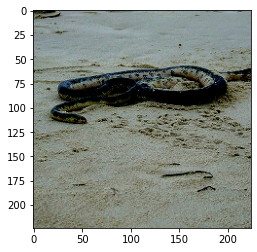

100%|██████████| 100/100 [00:08<00:00, 11.90it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 Queries: 151
__________________


Index: 1
INITIAL IMAGE


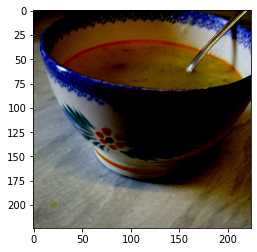

100%|██████████| 100/100 [00:07<00:00, 12.91it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 Queries: 143
__________________


Index: 2
INITIAL IMAGE


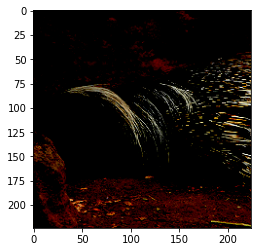

 37%|███▋      | 37/100 [00:03<00:05, 11.21it/s]


KeyboardInterrupt: 

In [22]:
simba_wrapper.run_simba()

In [29]:
simba_wrapper.X_modified[0].min()

-0.92156863

In [31]:
x_val_sample[0].min()

-0.92156863